# Colab

In [ ]:
!nvidia-smi -L  

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Not connected to a GPU


In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 13.6 gigabytes of available RAM

Not using a high-RAM runtime


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!rm -r sample_data

In [ ]:
# !pip install torch==1.4.0 torchvision==0.5.0

In [ ]:
!pip uninstall albumentations -y

Found existing installation: albumentations 1.2.1
Uninstalling albumentations-1.2.1:
  Successfully uninstalled albumentations-1.2.1


In [ ]:
 !pip install albumentations==1.0.3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 98 kB 2.9 MB/s 


In [ ]:
!pip uninstall opencv-python-headless -y

Found existing installation: opencv-python-headless 4.6.0.66
Uninstalling opencv-python-headless-4.6.0.66:
  Successfully uninstalled opencv-python-headless-4.6.0.66


In [ ]:
!pip install opencv-python-headless==4.1.2.30

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 21.8 MB 1.2 MB/s 


In [ ]:
import albumentations
albumentations.__version__

'1.0.3'

In [ ]:
## Remember focal loss order (targets outputs)
## accurqaacy _m tensor

# Load Data

In [ ]:
import pandas as pd
PATH = '/content/2019'

In [ ]:
import random
import matplotlib.pyplot as plt
import numpy as np
import cv2
def visualize_images(df, target=np.random.randint(8) ,row_col=(4,4), figsize=(12,12), microscopy_crop=False):
  plt.figure(figsize=figsize)
  plt.tight_layout
  p = np.array(df[df['target']==target].loc[:,'path'])
  t = np.array(df[df['target']==target].loc[:,'diagnosis'])
  row, col = row_col
  for k in range(row*col):
    try:
      r = np.random.randint(len(t)-1)
    except:
      continue
    l = t[r];i = p[r]
    img = cv2.imread(i); 
    img = cv2.resize(img, (224,244))
    if microscopy_crop:
      img = crop_microscopy(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  
    plt.subplot(row,col,k+1); plt.imshow(img/255.)
    plt.title(t[r], fontsize=12); plt.axis("off")
    # plt.title(p[r], fontsize=12); plt.axis("off")

## Get 2019 Data

In [ ]:
!mkdir ./2019
!unzip /content/drive/MyDrive/ISIC/2019/ISIC_2019_Training_Input.zip -d ./2019/train
!cp /content/drive/MyDrive/ISIC/2019/train.csv ./2019
!mv ./2019/train/ISIC_2019_Training_Input/* ./2019/train/
!rm -r ./2019/train/ISIC_2019_Training_Input
!rm ./2019/train/ATTRIBUTION.txt && rm ./2019/train/LICENSE.txt

Se truncaron las últimas líneas 5000 del resultado de transmisión.
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065357.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065358.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065359.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065360.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065361.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065362.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065366.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065367.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065368.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065370.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065371.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065372.jpg  
  inflating: ./2019/train/ISIC_2019_Training_Input/ISIC_0065374.jpg  
  inflating: ./2019/tra

## SD-198

In [ ]:
!mkdir 2019

mkdir: cannot create directory ‘2019’: File exists


In [ ]:
!mkdir ./2019/SD-198
!tar -xvf "/content/drive/MyDrive/ISIC/2019/SD-198/SD-198.tar" -C ./2019/SD-198/

Se truncaron las últimas líneas 5000 del resultado de transmisión.
images/Hyperkeratosis_Palmaris_Et_Plantaris/029179HB.jpg
images/Benign_Keratosis/013238HB.jpg
images/Junction_Nevus/011926HB.jpg
images/Cutanea_Larva_Migrans/10149-DSC01499.jpg
images/Tinea_Cruris/038171HB.jpg
images/Nevus_Sebaceous_of_Jadassohn/021681HB.jpg
images/Epidermal_Nevus/012240HB.jpg
images/Herpes_Simplex_Virus/041990HB.jpg
images/Nevus_Spilus/010524HB.jpg
images/Seborrheic_Keratosis/014248HB.jpg
images/Junction_Nevus/006068HB.jpg
images/Actinic_solar_Damage(Solar_Elastosis)/030165VB.jpg
images/Actinic_solar_Damage(Solar_Elastosis)/030255HB.jpg
images/Erythema_Craquele/030076VB.jpg
images/Dyshidrosiform_Eczema/029357HB.jpg
images/Pyoderma_Gangrenosum/045565HB.jpg
images/Psoriasis/044401HB.jpg
images/Myxoid_Cyst/020949HB.jpg
images/Solar_Lentigo/045113HB.jpg
images/Neurofibroma/022087HB.jpg
images/Urticaria/041098VB.jpg
images/Radiodermatitis/030380HB.jpg
images/Striae/030943HB.jpg
images/Epidermal_Nevus/012121

In [ ]:
sd198_path = PATH+'/SD-198/'

sd198_isic_classes = {'Actinic_solar_Damage(Actinic_Keratosis)' : 'AK',
                       'Basal_Cell_Carcinoma' : 'BCC',
                       'Dermatofibroma' : 'DF',
                       "Becker's_Nevus" : 'NV',
                       'Blue_Nevus' : 'NV',
                       'Congenital_Nevus' : 'NV',
                       'Benign_Keratosis' : 'BKL', 
                       'Seborrheic_Keratosis' : 'BKL', 
                       'Solar_Lentigo' : 'BKL', 
                       'Lichen_Planus' : 'BKL',
                       'Malignant_Melanoma' : 'MEL', 
                       'Metastatic_Carcinoma' : 'MEL',
                       'Lentigo_Maligna_Melanoma' : 'MEL'}
                       
def get_sd198_df():
    '''
    Credits: 
    https://github.com/j05t/lesion-analysis/blob/master/isic_classifier_se_resnext101_32x4d.ipynb
    '''
    sd198_classes = !ls -N {sd198_path}/images
    sd198_df = pd.DataFrame()
    for c in sd198_classes:
        images = !find "{sd198_path}images/{c}" -type f -name "*.jpg"
        df = pd.DataFrame()
        df['name'] = images
        
        if c not in sd198_isic_classes.keys():
            df['label'] = 'UNK'
            sd198_df = pd.concat([sd198_df, df])
        #else:
        #    df['label'] = sd198_isic_classes[c]   
        
    return sd198_df

In [ ]:
df = get_sd198_df()
df

,name,label
0,/content/2019/SD-198/images/Acne_Keloidalis_Nu...,UNK
1,/content/2019/SD-198/images/Acne_Keloidalis_Nu...,UNK
2,/content/2019/SD-198/images/Acne_Keloidalis_Nu...,UNK
3,/content/2019/SD-198/images/Acne_Keloidalis_Nu...,UNK
4,/content/2019/SD-198/images/Acne_Keloidalis_Nu...,UNK
...,...,...
33,/content/2019/SD-198/images/Xerosis/030058VB.jpg,UNK
34,/content/2019/SD-198/images/Xerosis/030362VB.jpg,UNK
35,/content/2019/SD-198/images/Xerosis/030087VB.jpg,UNK
36,/content/2019/SD-198/images/Xerosis/030051VB.jpg,UNK


In [ ]:
df['target'] = 0
df['path'] = df['name']
df['diagnosis'] = 'UNK'

In [ ]:
# for i in range(1):
#   visualize_images(df,i, row_col=(1,5), figsize= (14,14))

## PH2

In [ ]:
! mkdir ./2019/PH2/
!unrar x /content/drive/MyDrive/ISIC/2019/PH2/PH2Dataset.rar ./2019/PH2/


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/MyDrive/ISIC/2019/PH2/PH2Dataset.rar

Creating    ./2019/PH2/PH2Dataset                                     OK
Extracting  ./2019/PH2/PH2Dataset/PH2_dataset.txt                          0%  OK 
Extracting  ./2019/PH2/PH2Dataset/PH2_dataset.xlsx                         0%  OK 
Extracting  ./2019/PH2/PH2Dataset/Readme.txt                               0%  OK 
Creating    ./2019/PH2/PH2Dataset/PH2 Dataset images                  OK
Creating    ./2019/PH2/PH2Dataset/PH2 Dataset images/IMD002           OK
Creating    ./2019/PH2/PH2Dataset/PH2 Dataset images/IMD002/IMD002_Dermoscopic_Image  OK
Extracting  ./2019/PH2/PH2Dataset/PH2 Dataset images/IMD002/IMD002_Dermoscopic_Image/IMD002.bmp       0%  OK 
Creating    ./2019/PH2/PH2Dataset/PH2 Dataset images/IMD002/IMD002_lesion  OK
Extracting  ./2019/PH2/PH2Dataset/PH2 Dataset images/IMD002/IMD002_lesion/IMD002_

In [ ]:
ph2_path = PATH+'/PH2/PH2Dataset/'

def get_ph2_df():
    '''
    Credits: 
    https://github.com/j05t/lesion-analysis/blob/master/isic_classifier_se_resnext101_32x4d.ipynb
    '''
    df = pd.read_csv(ph2_path + 'PH2_dataset.txt', sep="\|\|", skipfooter=25, engine='python', usecols=[1,3])
    df.rename(columns={'   Name ': 'name', ' Clinical Diagnosis ': 'label'}, inplace=True)
    # 0: Common Nevus, 1: Atypical Nevus, 2: Melanoma.
    df.loc[df['label'] == 0, 'label'] = 'NV'
    df.loc[df['label'] == 1, 'label'] = 'NV'
    df.loc[df['label'] == 2, 'label'] = 'MEL'
    df['name'] = df['name'].apply(lambda x: "{0}PH2 Dataset images/{1}/{1}_Dermoscopic_Image/{1}.bmp".format(ph2_path,x.strip()))
    return df

In [ ]:
df = get_ph2_df()
df['path'] = df['name']
df['diagnosis'] = df['label']
df['target'] = df['diagnosis']
diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
df['target'] = df['diagnosis'].map(diagnosis_idx)
df

,name,label,path,diagnosis,target
0,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,1
1,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,1
2,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,1
3,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,1
4,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,NV,1
...,...,...,...,...,...
195,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,MEL,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,MEL,0
196,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,MEL,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,MEL,0
197,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,MEL,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,MEL,0
198,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,MEL,/content/2019/PH2/PH2Dataset/PH2 Dataset image...,MEL,0


In [ ]:
df.label.value_counts()

NV     160
MEL     40
Name: label, dtype: int64

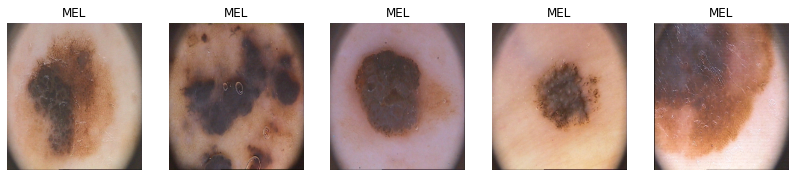

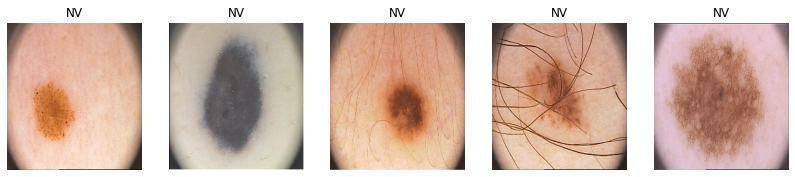

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

In [ ]:
for i in range(4):
  visualize_images(df,i, row_col=(1,5), figsize= (14,14))

## 7-point

In [ ]:
# # !tar -cvf /content/drive/MyDrive/ISIC/2019/7-point/7-point-images.tar ./7-point/
!mkdir ./2019/test & mkdir ./2019/7-point
!tar -xvf /content/drive/MyDrive/ISIC/2019/7-point/7-point-images.tar -C ./2019/test
!mv ./2019/test/content/drive/MyDrive/ISIC/2019/7-point ./2019
!rm -rf ./2019/test


content/drive/MyDrive/ISIC/2019/7-point/
content/drive/MyDrive/ISIC/2019/7-point/meta.csv
content/drive/MyDrive/ISIC/2019/7-point/test_indexes.csv
content/drive/MyDrive/ISIC/2019/7-point/train_indexes.csv
content/drive/MyDrive/ISIC/2019/7-point/valid_indexes.csv
content/drive/MyDrive/ISIC/2019/7-point/derm.html
content/drive/MyDrive/ISIC/2019/7-point/clinic.html
content/drive/MyDrive/ISIC/2019/7-point/README.txt
content/drive/MyDrive/ISIC/2019/7-point/release_v0.zip
content/drive/MyDrive/ISIC/2019/7-point/images/
content/drive/MyDrive/ISIC/2019/7-point/images/Ael/
content/drive/MyDrive/ISIC/2019/7-point/images/Ael/Ael455.jpg
content/drive/MyDrive/ISIC/2019/7-point/images/Ael/Ael523.jpg
content/drive/MyDrive/ISIC/2019/7-point/images/Ael/Ael409.jpg
content/drive/MyDrive/ISIC/2019/7-point/images/Ael/Ael521.jpg
content/drive/MyDrive/ISIC/2019/7-point/images/Ael/Ael519bis.jpg
content/drive/MyDrive/ISIC/2019/7-point/images/Ael/Ael465.jpg
content/drive/MyDrive/ISIC/2019/7-point/images/Ael/Ael

In [ ]:
derm7pt_path = PATH+'/7-point/'
def get_df_7point():
    '''
    Credits: 
    https://github.com/j05t/lesion-analysis/blob/master/isic_classifier_se_resnext101_32x4d.ipynb
    '''
    df = pd.read_csv(derm7pt_path + 'meta.csv', usecols=['derm', 'diagnosis'])
    df.rename(columns={'derm': 'name', 'diagnosis': 'label'}, inplace=True)
    
    df.loc[df['label'] == 'basal cell carcinoma', 'label'] = 'BCC'
    df.loc[df['label'] == 'lentigo', 'label'] = 'BKL'
    df.loc[df['label'] == 'seborrheic keratosis', 'label'] = 'BKL'
    df.loc[df['label'] == 'dermatofibroma', 'label'] = 'DF'
    df.loc[df['label'] == 'vascular lesion', 'label'] = 'VASC'
    # https://meshb.nlm.nih.gov/record/ui?ui=D008548
    df.loc[df['label'] == 'melanosis', 'label'] = 'BKL'
    # classified as benign melanocytic lesion
    # https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4866625/
    df.loc[df['label'] == 'reed or spitz nevus', 'label'] = 'NV'
    # Melanocytic nevus
    df.loc[df['label'] == 'blue nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'clark nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'combined nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'congenital nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'dermal nevus', 'label'] = 'NV'
    df.loc[df['label'] == 'melanoma', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma metastasis', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma (in situ)', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma (less than 0.76 mm)', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma (0.76 to 1.5 mm)', 'label'] = 'MEL'
    df.loc[df['label'] == 'melanoma (more than 1.5 mm)', 'label'] = 'MEL'
    # none of the others
    df.loc[df['label'] == 'miscellaneous', 'label'] = 'UNK'
    df.loc[df['label'] == 'recurrent nevus', 'label'] = 'UNK'
    
    df = df[['name', 'label']]
   
    df['name'] = df['name'].apply(lambda x: "{}images/{}".format(derm7pt_path,x))
    return df

NV      569
MEL     252
BKL      85
BCC      42
VASC     29
DF       20
UNK      14
Name: label, dtype: int64


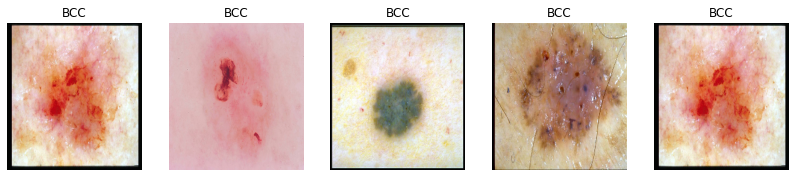

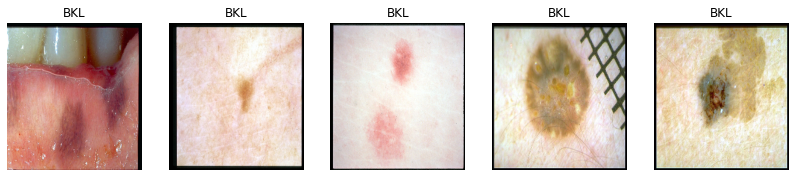

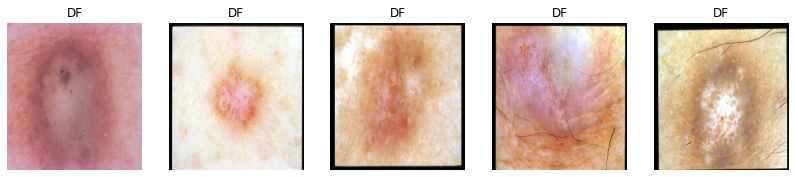

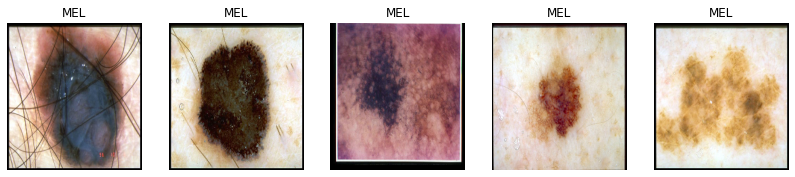

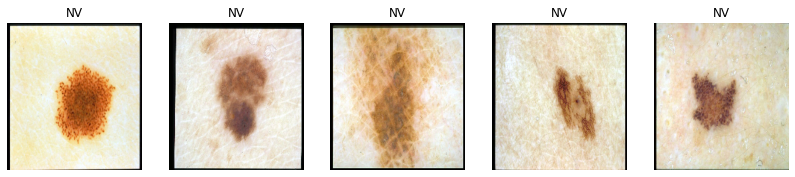

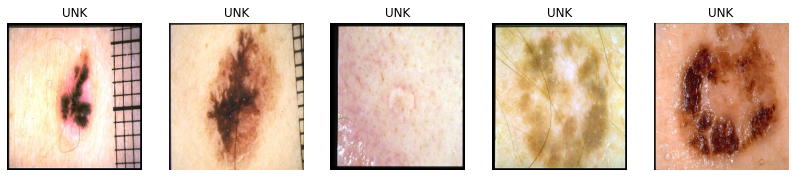

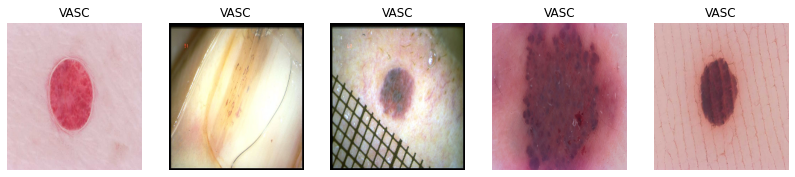

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

In [ ]:
df = get_df_7point()
df['path'] = df['name']
df['diagnosis'] = df['label']
df['target'] = df['diagnosis']
diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
df['target'] = df['diagnosis'].map(diagnosis_idx)

print(df.label.value_counts())
for i in range(10):
  visualize_images(df,i, row_col=(1,5), figsize= (14,14))

In [ ]:
# import os
# import shutil

# dir = "1959_6x6/"

# for file in os.listdir(dir):
#     # get all but the last 8 characters to remove
#     # the index number and extension
#     dir_name = file[-8]
#     print(f'dir_name: {dir_name}')

#     dir_path = dir + dir_name
#     print(f'dir_path: {dir_path}')
    
#     # check if directory exists or not yet
#     if not os.path.exists(dir_path):
#         os.makedirs(dir_path)

#     if os.path.exists(dir_path):
#         file_path = dir + file
#         print(f'file_path: {file_path}')
        
#         # move files into created directory
#         shutil.move(file_path, dir_path)

In [ ]:
# handle_images = get_df_7point()['tmp'].str.split('/', n=1, expand=True)
# handle_images[0].value_counts().index

In [ ]:
# import os
# import shutil
# path = '/content/drive/MyDrive/ISIC/2019/7-point/data/'
# path2 = '/content/drive/MyDrive/ISIC/2019/7-point/images/'
# for i, file in enumerate(handle_images[0]):
#   # check if directory exists or not yet
#   # if not os.path.exists(path+file):
#   #   print("im here?")
#   #   os.makedirs(path+file)

#   dir_path=path+handle_images[1][i]
#   print(f'dir_path: {dir_path}')
#   if os.path.exists(path2+file):
#     file_path = path2+file
#     print(f'file_path: {file_path}')

#     # move files into created directory
#     shutil.move(dir_path, file_path)

## MED-NODE

In [ ]:
!cp -r /content/drive/MyDrive/ISIC/2019/med-node ./2019/med-node

In [ ]:
mednode_path = PATH+'/med-node'
def get_mednode_df():
    mel = !find {mednode_path}/melanoma -type f -name '*jpg'
    nv = !find {mednode_path}/naevus -type f -name '*jpg'
    mel_df = pd.DataFrame(mel, columns =['image'])
    nv_df = pd.DataFrame(nv, columns =['image'])
    mel_df['label'] = 'MEL'
    nv_df['label'] = 'NV'
    df = pd.concat([mel_df, nv_df])
    df.rename(columns={'image': 'name'}, inplace=True)    
    return df

In [ ]:
df = get_mednode_df()

NV     100
MEL     70
Name: label, dtype: int64


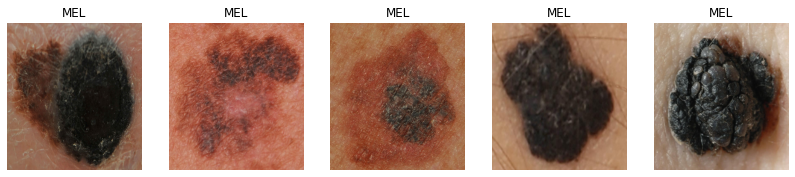

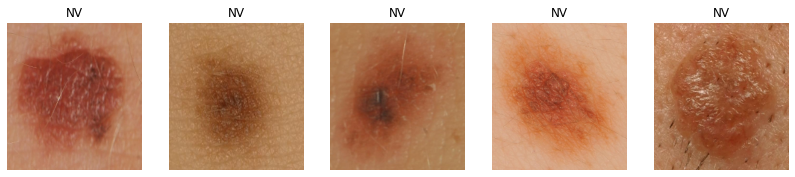

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

In [ ]:
df['path'] = df['name']
df['diagnosis'] = df['label']
df['target'] = df['diagnosis']
diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
df['target'] = df['diagnosis'].map(diagnosis_idx)

print(df.label.value_counts())
for i in range(10):
  visualize_images(df,i, row_col=(1,5), figsize= (14,14))

## SKINL2_v1_v2_v3

In [ ]:
!unzip /content/drive/MyDrive/ISIC/2019/SKINL2_v1_v2_v3/Dermatoscopic.zip -d ./2019/SKINL2_v1_v2_v3/

Archive:  /content/drive/MyDrive/ISIC/2019/SKINL2_v1_v2_v3/Dermatoscopic.zip
   creating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/
   creating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/
  inflating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/0040_Dermatoscopic.png  
  inflating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/0018_Dermatoscopic.png  
  inflating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/0075_Dermatoscopic.png  
  inflating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/0062_1_Dermatoscopic.png  
  inflating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/0082_Dermatoscopic.png  
  inflating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/0033_Dermatoscopic.png  
  inflating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/0084_Dermatoscopic.jpg  
  inflating: ./2019/SKINL2_v1_v2_v3/Dermatoscopic/Seborrheic-Keratosis/0016_Dermatoscopic.jpg  
  inflating: ./2019/SKINL2_v1_

In [ ]:
skinl_path = PATH+'/SKINL2_v1_v2_v3/Dermatoscopic'
def get_skinl_df():
    bcc = !find {skinl_path}/Basal-cell-Carcinoma -type f -name "*.png" -o -name '*.jpg'
    mel = !find {skinl_path}/Melanoma -type f -name "*.png" -o -name '*.jpg'
    bkl = !find {skinl_path}/Seborrheic-Keratosis -type f -name "*.png" -o -name '*.jpg'
    nv = !find {skinl_path}/Nevus -type f -name "*.png" -o -name '*.jpg'
    df = !find {skinl_path}/Dermatofibroma -type f -name "*.png" -o -name '*.jpg'
    unk = !find {skinl_path}/Others -type f -name "*.png" -o -name '*.jpg'
    bcc_df = pd.DataFrame(bcc)
    mel_df = pd.DataFrame(mel)
    bkl_df = pd.DataFrame(bkl)
    nv_df = pd.DataFrame(nv)
    df_df = pd.DataFrame(df)
    unk_df = pd.DataFrame(unk)

    bcc_df['label'] = 'BCC'
    mel_df['label'] = 'MEL'
    bkl_df['label'] = 'BKL'
    nv_df['label'] = 'NV'
    df_df['label'] = 'DF'
    unk_df['label'] = 'UNK'
    df = pd.concat([bcc_df, mel_df, bkl_df, nv_df, df_df, unk_df])
    df.columns = ['name', 'label']
    # df.reset_index(inplace=True)
    return df

In [ ]:
df = get_skinl_df()
df.label.value_counts()

NV     128
BKL     53
BCC     39
UNK     32
MEL     30
DF      17
Name: label, dtype: int64

NV     128
BKL     53
BCC     39
UNK     32
MEL     30
DF      17
Name: label, dtype: int64


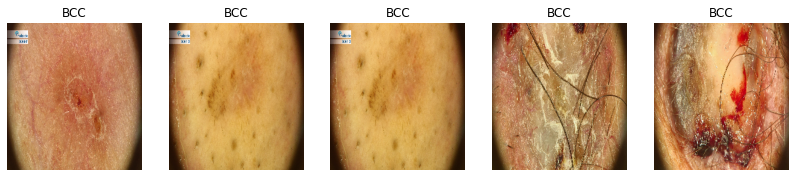

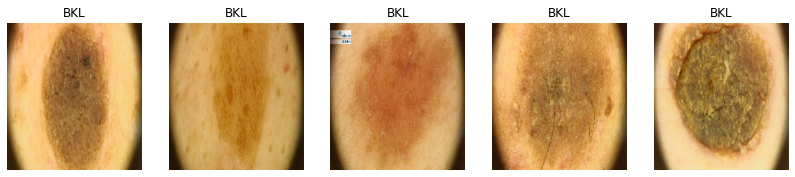

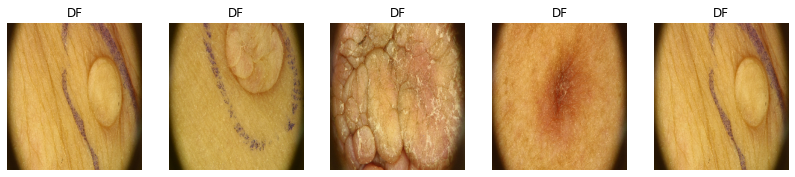

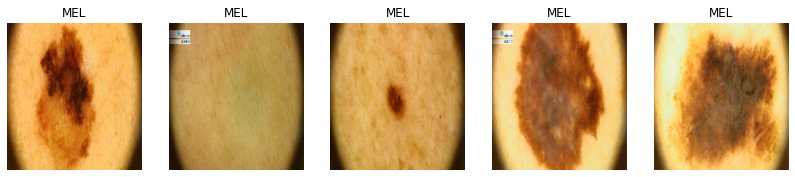

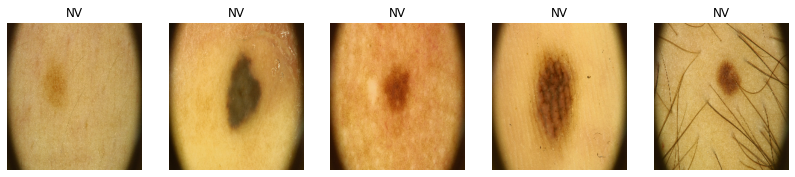

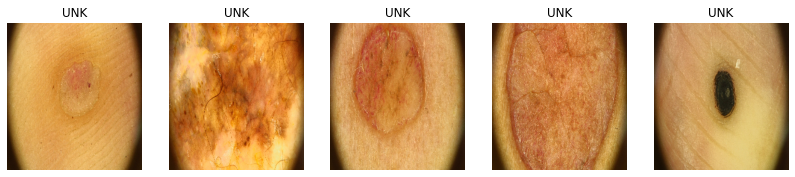

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

In [ ]:
df['path'] = df['name']
df['diagnosis'] = df['label']
df['target'] = df['diagnosis']
diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
df['target'] = df['diagnosis'].map(diagnosis_idx)

print(df.label.value_counts())
for i in range(10):
  visualize_images(df,i, row_col=(1,5), figsize= (14,14))

In [ ]:
# basal_fodler = t.loc[t.name.str.contains("Nevus", case=False)]
# # basal_fodler.loc[]
# t[basal_fodler.name.str.contains("0011_Dermatoscopic", case=False)]
# # t[ && t.label =='BCC']




In [ ]:
# a = !ls /content/2019/SKINL2_v1_v2_v3/Dermatoscopic/Dermatofibroma/
# a

## Get dataset

In [ ]:
def get_external_df():
    return pd.concat([get_sd198_df(), get_ph2_df(), get_df_7point(), get_skinl_df(), get_mednode_df()], sort=False)

## ISIC 2019

In [ ]:
import pandas as pd
import os

import numpy as np
from sklearn.model_selection import train_test_split

def to_path(image_name, path):
  return path + image_name + '.jpg'

def create_target(df):
  df['target'] = df['diagnosis']
  diagnosis_idx = {d: idx for idx, d in enumerate(sorted(df.diagnosis.unique()))}
  df['target'] = df['diagnosis'].map(diagnosis_idx)
  return df

def mapping(df, date):
  if date == '2019':
    df['diagnosis'] = None
    df['diagnosis'].mask(df['MEL']==1, 'MEL', inplace=True)
    df['diagnosis'].mask(df['NV']==1, 'NV', inplace=True)
    df['diagnosis'].mask(df['BCC']==1, 'BCC', inplace=True)
    df['diagnosis'].mask(df['AK']==1, 'AK', inplace=True)
    df['diagnosis'].mask(df['BKL']==1, 'BKL', inplace=True)
    df['diagnosis'].mask(df['DF']==1, 'DF', inplace=True)
    df['diagnosis'].mask(df['VASC']==1, 'VASC', inplace=True)
    df['diagnosis'].mask(df['SCC']==1, 'SCC', inplace=True)
    df['diagnosis'].mask(df['UNK']==1, 'UNK', inplace=True)
  if date == '2020':
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('seborrheic keratosis', 'BKL'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('lichenoid keratosis', 'BKL'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('solar lentigo', 'BKL'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('lentigo NOS', 'BKL'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('cafe-au-lait macule', 'UNK'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('atypical melanocytic proliferation', 'UNK'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('unknown', 'UNK'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('nevus', 'NV'))
    df['diagnosis'] = df['diagnosis'].apply(lambda x: x.replace('melanoma', 'MEL'))

  return df

def create_df(dir, file_name, val_size= 0.25, export_csv=False, subset = False, whole = False, external_data=False, date='2019'):
  '''
  Creates a dataframe with the following assertions
  file_name: name of the csv file (if name is 'test' only a path is added)
  export_csv: export dataframe
  whole: return the whole dataset the path and mapping
  subset: return a subset of the dataset with path and mapping
  '''
  df = pd.read_csv(f'{dir}/{file_name}.csv')
  if date == '2020':
    df = df.rename(columns={"image_name":"image"})
  df['path'] = df.image.apply(to_path, path = f'{dir}/{file_name}/')  

  if file_name == 'test':
    if export_csv:
      df.to_csv(f'{dir}/{file_name}.csv', index=False)
    return df.reset_index(drop=True)

  mapping(df, date)
  if external_data:
    ext = get_external_df()
    ext['diagnosis'] = ext['label']
    ext['path'] = ext['name']
    ext = ext.drop(columns='label')
    ext = ext.drop(columns='name')
    if whole:
      # ext = create_target(ext)
      if export_csv:
        ext.to_csv(f'{dir}/{file_name}_whole_ext.csv', index=False)
      return ext.reset_index(drop=True)
    else:
      ext = pd.concat([df, ext], sort=False)
      # ext = create_target(ext)
      df, df_val = train_test_split(ext, random_state=42, test_size=val_size, shuffle=True, stratify=ext['target'])
      if export_csv:
        df.to_csv(f'{dir}/train_ext.csv', index=False)
        df_val.to_csv(f'{dir}/val_ext.csv', index=False)
    return df.reset_index(drop=True), df_val.reset_index(drop=True)
  
  # df = create_target(df)
  if whole:
    if export_csv:
      df.to_csv(f'{dir}/{file_name}_whole.csv', index=False)
    return df.reset_index(drop=True)
  
  df, df_val = train_test_split(df, random_state=42, test_size=val_size, shuffle=True, stratify=df['target'])
  if subset:
    subset_, subset_val = train_test_split(df, random_state=42, test_size=0.33, shuffle=True, stratify=df['target'])
    if export_csv:
      df.to_csv(f'{dir}/subset.csv', index=False)
    return subset_.reset_index(drop=True), subset_val.reset_index(drop=True)
  if export_csv:
    df.to_csv(f'{dir}/train_split.csv', index=False)
    df_val.to_csv(f'{dir}/val_split.csv', index=False)
  return df.reset_index(drop=True), df_val.reset_index(drop=True)

Credits: 
https://github.com/j05t/lesion-analysis/blob/master/isic_classifier_se_resnext101_32x4d.ipynb

## Dataset 2020

In [ ]:
!mkdir ./2020
!unzip /content/drive/MyDrive/ISIC/2020/ISIC_2020_Training_JPEG.zip -d ./2020/train
!cp /content/drive/MyDrive/ISIC/2020/train.csv ./2020
!mv ./2020/train/train/* ./2020/train/
!rm -r ./2020/train/train
!rm ./2020/train/ATTRIBUTION.txt && rm ./2020/train/LICENSE.txt

Se truncaron las últimas líneas 5000 del resultado de transmisión.
  inflating: ./2020/train/train/ISIC_4667975.jpg  
  inflating: ./2020/train/train/ISIC_7672567.jpg  
  inflating: ./2020/train/train/ISIC_1870377.jpg  
  inflating: ./2020/train/train/ISIC_5941271.jpg  
  inflating: ./2020/train/train/ISIC_0298093.jpg  
  inflating: ./2020/train/train/ISIC_3830701.jpg  
  inflating: ./2020/train/train/ISIC_0528791.jpg  
  inflating: ./2020/train/train/ISIC_4167610.jpg  
  inflating: ./2020/train/train/ISIC_9392704.jpg  
  inflating: ./2020/train/train/ISIC_6084191.jpg  
  inflating: ./2020/train/train/ISIC_0242801.jpg  
  inflating: ./2020/train/train/ISIC_7763042.jpg  
  inflating: ./2020/train/train/ISIC_2256519.jpg  
  inflating: ./2020/train/train/ISIC_4575717.jpg  
  inflating: ./2020/train/train/ISIC_9407667.jpg  
  inflating: ./2020/train/train/ISIC_4187485.jpg  
  inflating: ./2020/train/train/ISIC_4576846.jpg  
  inflating: ./2020/train/train/ISIC_0736928.jpg  
  inflating: ./

In [ ]:
!cp /content/drive/MyDrive/ISIC/2019/whole_data.csv ./
!cp /content/drive/MyDrive/ISIC/2019/whole_data_unk.csv ./

In [ ]:
df_ = pd.read_csv(f'whole_data_unk.csv').reset_index(drop=True)
print(df_['diagnosis'].value_counts())
df, df_val = train_test_split(df_, random_state=42, test_size=0.125, shuffle=True, stratify=df_['target'])
df.to_csv(f'./train_whole.csv', index=False)
df_val.to_csv(f'./val_whole.csv', index=False)
print(df.shape, df_val.shape)
df = None
df_val = None

NV      13497
MEL      4813
UNK      4468
BCC      3383
BKL      2706
AK        867
SCC       628
DF        310
VASC      275
Name: diagnosis, dtype: int64
(27078, 14) (3869, 14)


## Get test data

In [ ]:
!mkdir 2019 && mkdir 2019/ISIC_2019_Test_Input
!unzip /content/drive/MyDrive/ISIC/2019/ISIC_2019_Test_Input.zip -d ./2019/ISIC_2019_Test_Input/
!mv ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input ./2019/test
!rm -rf ./2019/ISIC_2019_Test_Input
!rm ./2019/test/ATTRIBUTION.txt && rm ./2019/test/LICENSE.txt
!cp /content/drive/MyDrive/ISIC/2019/test.csv ./2019
!cp /content/drive/MyDrive/ISIC/2019/test_path.csv ./2019

Se truncaron las últimas líneas 5000 del resultado de transmisión.
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057952.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057954.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057955.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057956.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057957.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057961.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057965.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057967.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057968.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057971.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/ISIC_2019_Test_Input/ISIC_0057972.jpg  
  inflating: ./2019/ISIC_2019_Test_Input/I

In [ ]:
import pandas as pd
test_csv = "/content/2019/test_path.csv"
test = pd.read_csv(test_csv)
test.shape

(8238, 5)

# Create datasets

In [ ]:
!cp /content/drive/MyDrive/ISIC/2019/ISIC_2019_Training_Metadata.csv ./

In [ ]:
df_2019 = create_df(dir='/content/2019', file_name='train', whole = True, date='2019')
print(df_2019['diagnosis'].shape[0])
df_2019.drop(df_2019.columns.difference(['image','path','diagnosis']), axis=1, inplace=True)

df_meta_2019 = pd.read_csv(f'ISIC_2019_Training_Metadata.csv').reset_index(drop=True)
df_meta_2019.drop(columns={'image','lesion_id'}, axis=1, inplace=True)

df_2019 = pd.concat([df_2019, df_meta_2019], sort=False, axis=1)

df_2019['diagnosis'].value_counts()

25331


NV      12875
MEL      4522
BCC      3323
BKL      2624
AK        867
SCC       628
VASC      253
DF        239
Name: diagnosis, dtype: int64

In [ ]:
df_2020 = create_df(dir='/content/2020', file_name='train', whole = True, date='2020')
df_2020.rename(columns={"anatom_site_general_challenge": "anatom_site_general"}, inplace=True)
df_2020.drop(columns={'target','benign_malignant','patient_id'}, axis=1, inplace=True)
print(df_2020['diagnosis'].shape[0])
df_2020['diagnosis'].value_counts()

33126


UNK    27126
NV      5193
MEL      584
BKL      223
Name: diagnosis, dtype: int64

In [ ]:
df_2019_2020 = pd.concat([df_2019, df_2020], sort=False)
df_2019_2020.anatom_site_general.value_counts()

torso              16845
lower extremity    13407
upper extremity     7893
anterior torso      6915
head/neck           6442
posterior torso     2787
palms/soles          773
oral/genital         183
lateral torso         54
Name: anatom_site_general, dtype: int64

In [ ]:
derm7pt_path = PATH+'/7-point/'
t=None
df = pd.read_csv(derm7pt_path + 'meta.csv')

if 'age_approx' not in df.columns:
  df['age_approx'] = 0

if 'location' in df.columns:
  df.rename(columns={"location": "anatom_site_general"}, inplace=True)
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('chest', 'torso'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('back', 'posterior torso'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('lower limbs', 'lower extremity'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('abdomen', 'anterior torso'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('upper limbs', 'upper extremity'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('head neck', 'head/neck'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('buttocks', 'unknown'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('acral', 'upper extremity'))
  df['anatom_site_general'] = df['anatom_site_general'].apply(lambda x: x.replace('genital areas', 'oral/genital'))
df.anatom_site_general.value_counts()

posterior torso    281
lower extremity    200
upper extremity    184
anterior torso     125
torso              100
head/neck           92
unknown             21
oral/genital         8
Name: anatom_site_general, dtype: int64

In [ ]:
# ext = create_df(dir='/content/2019', file_name='train', whole = True, external_data=True)
# print(ext['diagnosis'].shape[0])
# ext['diagnosis'].value_counts()

In [ ]:
# df__ = pd.concat([df_, ext], sort=False)
# df__ = create_target(df__)
# print(df__.diagnosis.shape[0])
# df__.diagnosis.value_counts()
# df__.to_csv(f'whole_data.csv', index=False)

In [ ]:
# !cp ./whole_data.csv /content/drive/MyDrive/ISIC/ 
!cp /content/drive/MyDrive/ISIC/whole_data.csv ./ 

## Remove duplicates

In [ ]:
# !cp /content/drive/MyDrive/ISIC/2019/duplicates_whole_filenames.csv ./

In [ ]:
# df_ = pd.read_csv(f'whole_data.csv').reset_index(drop=True)
# print(df_.shape)
# df_.diagnosis.value_counts()

In [ ]:
# duplicates = pd.read_csv(f'duplicates_whole_filenames.csv').reset_index(drop=True)
# df_['temporal_image'] = df_.image[df_.image.notnull()] + '.jpg'
# df_ = df_[~df_.temporal_image.isin(duplicates.image_pair)]
# df_.shape

In [ ]:
# df_.to_csv(f'whole_data_no_duplicates.csv', index=False)

In [ ]:
# !cp ./whole_data_no_duplicates.csv /content/drive/MyDrive/ISIC/
!cp /content/drive/MyDrive/ISIC/whole_data_no_duplicates.csv ./

In [ ]:
# from sklearn.model_selection import train_test_split
# df_ = pd.read_csv(f'whole_data_no_duplicates.csv').reset_index(drop=True)
# print(df_['diagnosis'].value_counts())
# df, df_val = train_test_split(df_, random_state=42, test_size=0.136, shuffle=True, stratify=df_['target'])
# df.to_csv(f'./train_whole_no_duplicates.csv', index=False)
# df_val.to_csv(f'./val_whole_no_duplicates.csv', index=False)
# print(df.shape, df_val.shape)
# df = None
# df_ = None
# df_val = None

# !cp ./train_whole_no_duplicates.csv /content/drive/MyDrive/ISIC/
# !cp ./val_whole_no_duplicates.csv /content/drive/MyDrive/ISIC/

!cp /content/drive/MyDrive/ISIC/train_whole_no_duplicates.csv ./
!cp /content/drive/MyDrive/ISIC/val_whole_no_duplicates.csv ./

# Identify Duplicates

Competitor host admits there [true duplicates](https://www.kaggle.com/competitions/siim-isic-melanoma-classification/discussion/161943) on 2020 dataset. Since the new is composed of 2019+2020, identifying duplicates is a must to avoid leaks on validation data, more importantly when performing cross.

### RAPIDS cuML kNN
[@Chris Deotte](https://www.kaggle.com/cdeotte) 

In [ ]:
!nvidia-smi -L 
import pynvml

pynvml.nvmlInit()
handle = pynvml.nvmlDeviceGetHandleByIndex(0)
device_name = pynvml.nvmlDeviceGetName(handle)

if (device_name != b'Tesla T4') and (device_name != b'Tesla P4') and (device_name != b'Tesla P100-PCIE-16GB'):
  raise Exception("""
    Unfortunately this instance does not have a T4, P4 or P100 GPU.
    
    Please make sure you've configured Colab to request a GPU instance type.
    
    Sometimes Colab allocates a Tesla K80 instead of a T4, P4 or P100. Resetting the instance.
If you get a K80 GPU, try Runtime -> Reset all runtimes...
  """)
else:
  print('Woo! You got the right kind of GPU!')

GPU 0: Tesla T4 (UUID: GPU-14aeed2d-6068-f95b-89a1-e785926a675c)
Woo! You got the right kind of GPU!


In [ ]:
# Install RAPIDS
!git clone https://github.com/rapidsai/rapidsai-csp-utils.git
!bash rapidsai-csp-utils/colab/rapids-colab.sh stable

import sys, os

dist_package_index = sys.path.index('/usr/local/lib/python3.7/dist-packages')
sys.path = sys.path[:dist_package_index] + ['/usr/local/lib/python3.7/site-packages'] + sys.path[dist_package_index:]
sys.path
exec(open('/content/rapidsai-csp-utils/colab/rapids-colab.sh').read(), globals())

fatal: destination path 'rapidsai-csp-utils' already exists and is not an empty directory.
PLEASE READ FOR 21.06
********************************************************************************************************
Another release, another script change.  We had to revise the script, which now:
1. Does a more comprehensive install
2. Includes BlazingSQL
3. is far easier for everyone to understand and maintain

The script will require you to add these 5 cells to your notebook.  We have also created a new startup template: 
https://colab.research.google.com/drive/1TAAi_szMfWqRfHVfjGSqnGVLr_ztzUM9?usp=sharing

CHANGES T
CELL 1:
    # This get the RAPIDS-Colab install files and test check your GPU.  Run cells 1 and 2 only.
    # Please read the output of this cell.  If your Colab Instance is not RAPIDS compatible, it will warn you and give you remediation steps.
    !git clone https://github.com/rapidsai/rapidsai-csp-utils.git
    !python rapidsai-csp-utils/colab/env-check.py

CELL 2:
 

SyntaxError: ignored

In [ ]:
!pip install -q efficientnet >> /dev/null

In [ ]:
import pandas as pd, numpy as np
import tensorflow as tf, re, math
import tensorflow.keras.backend as K
import efficientnet.tfkeras as efn
from sklearn.model_selection import KFold
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt, cv2
import cupy as cuml #, cupy
print('RAPIDS version',cuml.__version__)

RAPIDS version 9.4.0


In [ ]:
DIM = 256; EFFN = 0; BATCH_SIZE = 128
LOAD_EMBEDDINGS = False
if LOAD_EMBEDDINGS: print('We will read embeddings from Kaggle dataset')
else: print('We will extract embeddings from pretrained CNN')
PATH_TO_EMBEDDINGS = '../input/embeddings-melanoma/'

We will extract embeddings from pretrained CNN


In [ ]:
# RESTRICT TENSORFLOW TO 12GB OF GPU RAM
# SO THAT WE HAVE GPU RAM FOR RAPIDS CUML KNN
LIMIT = 12
if LOAD_EMBEDDINGS: LIMIT = 0
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  try:
    tf.config.experimental.set_virtual_device_configuration(
        gpus[0],
        [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=1024*12)])
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    print(e)
print('Restrict TensorFlow to max %iGB GPU RAM'%LIMIT)

1 Physical GPUs, 1 Logical GPUs
Restrict TensorFlow to max 12GB GPU RAM


In [ ]:
def read_labeled_tfrecord(example):
    tfrec_format = {
        'image'                        : tf.io.FixedLenFeature([], tf.string),
        'image_name'                   : tf.io.FixedLenFeature([], tf.string),
        'target'                       : tf.io.FixedLenFeature([], tf.int64)
    }           
    example = tf.io.parse_single_example(example, tfrec_format)
    return example['image'], example['target']


def read_unlabeled_tfrecord(example, return_image_name):
    tfrec_format = {
        'image'                        : tf.io.FixedLenFeature([], tf.string),
        'image_name'                   : tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(example, tfrec_format)
    return example['image'], example['image_name'] if return_image_name else 0

 
def prepare_image(img, augment=True, dim=256):    
    img = tf.image.decode_jpeg(img, channels=3)
    # NORMALIZE IMAGES TO IMAGENET PRETRAIN
    img = ((tf.cast(img, tf.float32) / 255.0) - 0.449) / 0.226                      
    img = tf.reshape(img, [dim,dim, 3])
    return img

def count_data_items(filenames):
    n = [int(re.compile(r"-([0-9]*)\.").search(filename).group(1)) 
         for filename in filenames]
    return np.sum(n)

In [ ]:
def get_dataset(files, augment = False, shuffle = False, repeat = False, 
                labeled=True, return_image_names=True, batch_size=32, dim=128):
    
    ds = tf.data.TFRecordDataset(files, num_parallel_reads=AUTO)
    ds = ds.cache()
    
    if repeat:
        ds = ds.repeat()
    
    if shuffle: 
        ds = ds.shuffle(1024*8)
        opt = tf.data.Options()
        opt.experimental_deterministic = False
        ds = ds.with_options(opt)
        
    if labeled: 
        ds = ds.map(read_labeled_tfrecord, num_parallel_calls=AUTO)
    else:
        ds = ds.map(lambda example: read_unlabeled_tfrecord(example, return_image_names), 
                    num_parallel_calls=AUTO)      
    
    ds = ds.map(lambda img, imgname_or_label: (prepare_image(img, augment=augment, dim=dim), 
                                               imgname_or_label), 
                num_parallel_calls=AUTO)
    
    ds = ds.batch(batch_size * REPLICAS)
    ds = ds.prefetch(AUTO)
    return ds

In [ ]:
# EXTRACT LAST LAYER OF EFFICIENT NET WITH GLOBAL AVERAGE POOLING
EFNS = [efn.EfficientNetB0, efn.EfficientNetB1, efn.EfficientNetB2, efn.EfficientNetB3, 
        efn.EfficientNetB4, efn.EfficientNetB5, efn.EfficientNetB6]

def build_model(dim=256, ef=EFFN):
    inp = tf.keras.layers.Input(shape=(dim,dim,3))
    base = EFNS[ef](input_shape=(dim,dim,3),weights='imagenet',include_top=False)
    x = base(inp)
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    model = tf.keras.Model(inputs=inp,outputs=x)
    return model

In [ ]:
# TFRECORDS PATH
GCS_PATH = '../input/melanoma-%ix%i'%(DIM,DIM) # GPU does not need KaggleDatasets()
files_train = np.sort(np.array(tf.io.gfile.glob(GCS_PATH + '/train*.tfrec')))
files_test  = np.sort(np.array(tf.io.gfile.glob(GCS_PATH + '/test*.tfrec')))
AUTO     = tf.data.experimental.AUTOTUNE; REPLICAS = 1

In [ ]:
if not LOAD_EMBEDDINGS:
    model = build_model(dim=DIM,ef=EFFN)
    ds_train = get_dataset(files_train,labeled=False,return_image_names=False,augment=False,
            repeat=False,shuffle=False,dim=DIM,batch_size=BATCH_SIZE)
    embed = model.predict(ds_train,verbose=1)
    np.save('embed_train_%i_%i'%(DIM,EFFN),embed.astype('float32'))
else:
    embed = np.load(PATH_TO_EMBEDDINGS+'embed_train_%i_%i.npy'%(DIM,EFFN))
print('train embeddings shape',embed.shape)

ValueError: ignored

### Find duplicates

In [ ]:
KNN = 3
model = cuml.neighbors.NearestNeighbors(n_neighbors=KNN)
model.fit(embed_ext)
distances, indices = model.kneighbors(embed_test)

mm = np.min(distances,axis=1)
plt.title('Shortest Distances of Test Images to any 2019 Image')
plt.hist(mm)
plt.show()

In [ ]:
CUTOFF = 2
idx = np.where( (mm<CUTOFF) )[0]
print('There are %i potential duplicate images that have distance < %i'%(len(idx),CUTOFF))

In [ ]:
skf = KFold(n_splits=5,shuffle=True,random_state=42)
oof = np.zeros((train.shape[0]))
folds = np.zeros((train.shape[0]))
preds = np.zeros((test.shape[0]))

for fold,(idxT,idxV) in enumerate(skf.split(np.arange(15))):
    
    # DISPLAY FOLD INFO
    print('#'*25); print('#### FOLD',fold+1)
    
    # CREATE TRAIN AND VALIDATION SUBSETS
    idxT2 = train.loc[train.tfrecord.isin(idxT)].index.values #2020 train
    idxV2 = train.loc[train.tfrecord.isin(idxV)].index.values #2020 valid
    
    model = cuml.neighbors.KNeighborsClassifier(n_neighbors=299)
    model.fit(embed[idxT2,],train.target.values[idxT2])
        
    oof[idxV2] = model.predict_proba(embed[idxV2,])[:,1]  
    preds += model.predict_proba(embed_test)[:,1] / skf.n_splits
    
    # REPORT RESULTS
    folds[idxV2] = fold
    auc = roc_auc_score(train.target.values[idxV2],oof[idxV2])
    print('#### OOF AUC = %.3f'%auc)
    print('#'*25); print()    
    
auc = roc_auc_score(train.target.values,oof)
print('Overall OOF AUC = %.3f'%auc)

In [ ]:
# WRITE OOF TO DISK
train['pred'] = oof; train['fold'] = folds
train[['image_name','target','pred','fold']].to_csv('oof.csv',index=False)
train[['image_name','target','pred','fold']].head()

In [ ]:
# PLOT TEST PREDICTION HISTOGRAM
plt.hist(submission.target,bins=50)
plt.show()

### KMEANS

In [ ]:
CLUSTERS = 20
model = cuml.KMeans(n_clusters=CLUSTERS)
model.fit(embed)
train['cluster'] = model.labels_
train.head()

In [ ]:
PATH_TRAIN = '../input/jpeg-melanoma-128x128/train/'

for k in range(CLUSTERS):
    print('#'*25);
    print('#### Cluster %i of similar train images'%k)
    print('#'*25)
    df = train.loc[train.cluster==k]
    plt.figure(figsize=(20,10))
    for j in range(8):
        plt.subplot(2,4,j+1)
        img = cv2.imread(PATH_TRAIN+names[df.index[j]]+'.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.axis('off')
        plt.title('%s, Target = %i'%(names[df.index[j]],df.loc[df.index[j],'target']))
        plt.imshow(img)  
    plt.show()
    

### RAPIDS cuML TSNE

In [ ]:
model = cuml.TSNE()
embed2D = model.fit_transform(embed)
train['x'] = embed2D[:,0]
train['y'] = embed2D[:,1]


In [ ]:
X_DIV = 10; Y_DIV = 10
x_min = train.x.min()
x_max = train.x.max()
y_min = train.y.min()
y_max = train.y.max()
x_step = (x_max - x_min)/X_DIV
y_step = (y_max - y_min)/Y_DIV
mx = 0; xa_mx = 0; xb_mx=0; ya_mx = 0; yb_mx = 0
for k in range(X_DIV+1):
    for j in range(Y_DIV+1):
        xa = k*x_step + x_min
        xb = (k+1)*x_step + x_min
        ya = j*y_step + y_min
        yb = (j+1)*y_step + y_min
        df = train.loc[(train.x>xa)&(train.x<xb)&(train.y>ya)&(train.y<yb)]
        t = df.target.mean()
        if (t>mx)&(len(df)>=16):
            mx = t
            xa_mx = xa
            xb_mx = xb
            ya_mx = ya
            yb_mx = yb
        #print(k,j,t)

In [ ]:
plt.figure(figsize=(10,10))
df1 = train.loc[train.target==0]
plt.scatter(df1.x,df1.y,color='orange',s=10,label='Benign')
df2 = train.loc[train.target==1]
plt.scatter(df2.x,df2.y,color='blue',s=10,label='Malignant')
plt.plot([xa_mx,xa_mx],[ya_mx,yb_mx],color='black')
plt.plot([xa_mx,xb_mx],[ya_mx,ya_mx],color='black')
plt.plot([xb_mx,xb_mx],[ya_mx,yb_mx],color='black')
plt.plot([xa_mx,xb_mx],[yb_mx,yb_mx],color='black')
plt.legend()
plt.show()

In [ ]:
df = train.loc[(train.x>xa_mx)&(train.x<xb_mx)&(train.y>ya_mx)&(train.y<yb_mx)]
print('This region has %.2f %% malignant'%(100*df.target.mean())) 

ROW = 4
COL = 4
plt.figure(figsize=(20,20*ROW/COL))
for k in range(ROW):
    for j in range(COL):
        plt.subplot(ROW,COL,k*COL+j+1)
        img = cv2.imread(PATH_TRAIN+names[df.index[k*COL+j]]+'.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.axis('off')
        plt.title('%s, Target = %i'%(names[df.index[k*COL+j]],df.loc[df.index[k*COL+j],'target']))
        plt.imshow(img)  
plt.show()

### imagededup



In [ ]:
!pip install --no-deps imagededup==0.2.2 > /dev/null

In [ ]:
import pandas as pd
df_folds = pd.read_csv(f'./2020/train.csv', index_col='image_name')

TRAIN_IMAGE_IDS = df_folds.index.values
TRAIN_CLUSTERS = []
TRAIN_CLUSTERING_CACHE = set()
BAD_CASES_CACHE = set()

In [ ]:
df_folds

,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
image_name,,,,,,,
ISIC_2637011,IP_7279968,male,45.0,head/neck,unknown,benign,0
ISIC_0015719,IP_3075186,female,45.0,upper extremity,unknown,benign,0
ISIC_0052212,IP_2842074,female,50.0,lower extremity,nevus,benign,0
ISIC_0068279,IP_6890425,female,45.0,head/neck,unknown,benign,0
ISIC_0074268,IP_8723313,female,55.0,upper extremity,unknown,benign,0
...,...,...,...,...,...,...,...
ISIC_9999134,IP_6526534,male,50.0,torso,unknown,benign,0
ISIC_9999320,IP_3650745,male,65.0,torso,unknown,benign,0
ISIC_9999515,IP_2026598,male,20.0,lower extremity,unknown,benign,0


In [ ]:
!mkdir data
!mv ./2019/train/* ./data/
!mv ./2020/train/* ./data/

In [ ]:
from imagededup.methods import PHash

phasher = PHash()

encodings = phasher.encode_images(image_dir=f'./data')
duplicates = phasher.find_duplicates(encoding_map=encodings, max_distance_threshold=0)

2022-09-20 17:31:48,287: INFO Start: Calculating hashes...
INFO:imagededup.methods.hashing:Start: Calculating hashes...
 50%|████▉     | 29000/58457 [1:18:32<1:19:46,  6.15it/s]Process ForkPoolWorker-1:
Traceback (most recent call last):
  File "/usr/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/usr/lib/python3.7/multiprocessing/process.py", line 99, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/lib/python3.7/multiprocessing/pool.py", line 121, in worker
    result = (True, func(*args, **kwds))
  File "/usr/lib/python3.7/multiprocessing/pool.py", line 44, in mapstar
    return list(map(*args))
Process ForkPoolWorker-2:
  File "/usr/local/lib/python3.7/dist-packages/imagededup/methods/hashing.py", line 110, in encode_image
    image_file=image_file, target_size=self.target_size, grayscale=True
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/imagededup/utils/image_utils.py", line 77, in loa

KeyboardInterrupt: ignored

In [ ]:
t = []
for e in duplicates.items():
  if e[1]:
    l = e[0],e[1]
    t.append(l)
  else:
    pass

In [ ]:
df = pd.DataFrame(t, columns=['image_id','image_pair'])
df.to_csv(f'/content/drive/MyDrive/ISIC/2019/duplicates_whole.csv', index=False)

NameError: ignored

# Load duplicates

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/ISIC/2019/duplicates_whole.csv')
df.shape

(1162, 2)

In [ ]:
df.shape

(1162, 2)

In [ ]:
!mkdir data
!mv ./2019/train/* ./data/
!mv ./2020/train/* ./data/

mkdir: cannot create directory ‘data’: File exists
mv: cannot stat '2019/train/*': No such file or directory
mv: cannot stat '2020/train/*': No such file or directory


In [ ]:
df

,image_id,image_pair
0,ISIC_5756962.jpg,['ISIC_7241455.jpg']
1,ISIC_1087658.jpg,['ISIC_7102070.jpg']
2,ISIC_3707449.jpg,['ISIC_0385633.jpg']
3,ISIC_0586782.jpg,['ISIC_8732572.jpg']
4,ISIC_3772694.jpg,['ISIC_2287083.jpg']
...,...,...
1157,ISIC_0072272.jpg,['ISIC_0054792.jpg']
1158,ISIC_6373822.jpg,['ISIC_1601244.jpg']
1159,ISIC_0072170.jpg,['ISIC_0065795.jpg']
1160,ISIC_2081142.jpg,['ISIC_3689759.jpg']


### view 1

In [ ]:
import cv2
import random
import matplotlib.pyplot as plt

r, c = 4, 2
fig = plt.figure(figsize=(3*c, 3*r))

ix = random.randint(0, df.shape[0]-1)
t = [df['image_id'][ix], df['image_pair'][ix]]
t

['ISIC_6847618.jpg', "['ISIC_0016053_downsampled.jpg']"]

<Figure size 432x864 with 0 Axes>

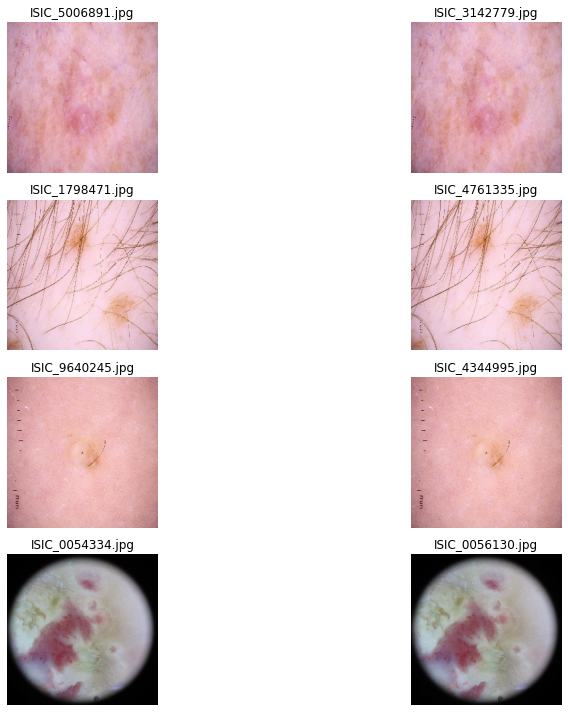

In [ ]:
# t = ['ISIC_2718135', 'ISIC_9409255']
# t = ['ISIC_0072170', 'ISIC_0065795']

# a = '/content/2019/train/'+t[0]
# a
ix=0
for _r in range(r):
  count = 0
  ix = ix+ 1
  ix = random.randint(0, df.shape[0]-1)
  if ix == 4:
    break
  for _c in range(c):
    ax = plt.subplot(r, c, _r*c + _c + 1)
    t = [df['image_id'][ix], df['image_pair'][ix]]
    if count == 1:
      t_ = t[count][2:-2]
      img = cv2.imread('/content/data/'+t[count][2:-2])
    else:
      t_ = t[count]
      img = cv2.imread('/content/data/'+t[count])
    img = cv2.resize(img, (224,224))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.title(t_, fontsize=12)
    plt.axis("off")
    plt.imshow(img)
    count=count+1
plt.tight_layout()
plt.show()


### view 2

In [ ]:
# do some imports for plotting
from pathlib import Path
from imagededup.utils import plot_duplicates
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (15, 10)

### generate csv duplicates

In [ ]:
filenames_2020 = set([i.name for i in Path('/content/data').glob('*.jpg')])

# keep only filenames that are in 2020 train set
duplicates_2020 = {}
for k, v in duplicates.items():
  if k in filenames_2020:
    tmp = [i for i in v if i in filenames_2020]
    duplicates_2020[k] = tmp
    
# sort in descending order of duplicates
duplicates_2020 = {k: v for k, v in sorted(duplicates_2020.items(), key=lambda x: len(x[1]), reverse=True)}

In [ ]:
t = []
for e in duplicates_2020.items():
  if e[1]:
    l = e[0],e[1][0]
    t.append(l)
  else:
    pass
df_ = pd.DataFrame(t, columns=['image_id', 'image_pair'])
# df_.to_csv(f'/content/drive/MyDrive/ISIC/2019/duplicates_whole_filenames.csv', index=False)

### load csv duplicates

In [ ]:
!cp /content/drive/MyDrive/ISIC/2019/duplicates_whole_filenames.csv ./

In [ ]:
df_.shape

(0, 2)

In [ ]:
!cp /content/drive/MyDrive/ISIC/2019/duplicates_whole_filenames.csv ./
duplicates = pd.read_csv(f'duplicates_whole_filenames.csv').reset_index(drop=True)
duplicates.shape

(1162, 2)

In [ ]:
plot_duplicates(image_dir='data', duplicate_map=duplicates_2020, filename=list(duplicates_2020.keys())[51])

IndexError: ignored

In [ ]:
filenames_2019 = set([i.name for i in Path('/content/2019/train').glob('*.jpg')])

# keep only filenames that are in 2019 set
duplicates_2019 = {}
for k, v in duplicates.items():
  if k in filenames_2019:
    print(k)
    tmp = [i for i in v if i in filenames_2019]
    duplicates_2019[k] = tmp    

# sort in descending order of duplicates
duplicates_2019 = {k: v for k, v in sorted(duplicates_2019.items(), key=lambda x: len(x[1]), reverse=True)}

In [ ]:
t = []
for e in duplicates_2019.items():
  if e[1]:
    l = e[0],e[1]
    t.append(e)
  else:
    pass
df_ = pd.DataFrame(t, columns=['image_id', 'image_pair'])
# df_.to_csv(f'/content/drive/MyDrive/ISIC/2019/duplicates_2019.csv', index=False)
df_.shape

(0, 2)

In [ ]:
# keep only filenames that are in test set have duplicates in train set
duplicates_2020_2019 = {}
for k, v in duplicates.items():
    if k in filenames_2020:
        tmp = [i for i in v if i in filenames_2020]
        duplicates_2020_2019[k] = tmp
    
# sort in descending order of duplicates
duplicates_2020_2019 = {k: v for k, v in sorted(duplicates_2020_2019.items(), key=lambda x: len(x[1]), reverse=True)}
# duplicates_2020_2019.shape

In [ ]:
plot_duplicates(image_dir='2020/train', duplicate_map=duplicates_2020_2019, filename=list(duplicates_2020_2019.keys())[50])

IndexError: ignored

In [ ]:
df_ = pd.read_csv(f'whole_data.csv').reset_index(drop=True)
print(df_['diagnosis'].value_counts())
df, df_val = train_test_split(df_, random_state=42, test_size=0.125, shuffle=True, stratify=df_['target'])
df.to_csv(f'./train_whole_60_no_duplicates.csv', index=False)
df_val.to_csv(f'./val_whole_60_no_duplicates.csv', index=False)
print(df.shape, df_val.shape)
df = None
df_ = None
df_val = None

# EDA

In [ ]:
# df = pd.read_csv('./whole_data.csv')
df = pd.read_csv(f'whole_data_no_duplicates.csv').reset_index(drop=True)

In [ ]:
# df = test
df.shape

(57301, 8)

## Visualize

In [ ]:
def crop_microscopy(img):
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU + cv2.THRESH_BINARY)[1]
  # Find contour and sort by contour area
  cnts = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  cnts = cnts[0] if len(cnts) == 2 else cnts[1]
  cnts = sorted(cnts, key=cv2.contourArea, reverse=True)
  # Find bounding box and extract ROI
  for c in cnts:
    x,y,w,h = cv2.boundingRect(c)
    ROI = img[y:y+h, x:x+w]
    break
  return ROI
  # cv2_imshow(ROI)
  # print(ROI.shape)

In [ ]:
import random
import matplotlib.pyplot as plt
import numpy as np
import cv2
def visualize_images(df, target=np.random.randint(8) ,row_col=(4,4), figsize=(12,12), microscopy_crop=False):
  plt.figure(figsize=figsize)
  plt.tight_layout
  p = np.array(df[df['target']==target].loc[:,'path'])
  t = np.array(df[df['target']==target].loc[:,'diagnosis'])
  row, col = row_col
  for k in range(row*col):
    try:
      r = np.random.randint(len(t)-1)
    except:
      continue
    l = t[r];i = p[r]
    img = cv2.imread(i); 
    img = cv2.resize(img, (224,244))
    if microscopy_crop:
      img = crop_microscopy(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  
    plt.subplot(row,col,k+1); plt.imshow(img/255.)
    plt.title(t[r], fontsize=12); plt.axis("off")
    # plt.title(p[r], fontsize=12); plt.axis("off")

In [ ]:
for i in range(8):
  visualize_images(df,i, row_col=(1,5), figsize= (15,15))

In [ ]:
# check skinl_v1_v2_v3 crop
# from google.colab.patches import cv2_imshow
# # t.reset.reset_index(inplace=True)
# img = cv2.imread(t.name[3])
# img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
# img_ = crop_microscopy(img)
# cv2_imshow(img_)
# print(img.shape, img_.shape)

## Outliers with mean and standard deviation

[@Ram(ji)](https://www.kaggle.com/code/ramjib/cassava-leaf-disease-eda-and-outliers/notebook) based EDA


Size and Aspect ratio

In [ ]:
                                                                                                                                         from tqdm import tqdm
import cv2

for idx in tqdm(df.index):
    img_name = df.loc[idx,'path']
    img = cv2.cvtColor(cv2.imread(df.path[idx]), cv2.COLOR_BGR2RGB)    
    w,h,_ = img.shape
    df.loc[idx,'width'] = w
    df.loc[idx,'height'] = h
    df.loc[idx,'ratio'] = w/h

    df.loc[idx,'mean'] = img.mean()
    df.loc[idx,'std'] = img.std()
    
    img_norm = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    df.loc[idx,'mean_norm'] = img_norm.mean()
    df.loc[idx,'std_norm'] = img_norm.std()

 39%|███▉      | 22472/57301 [13:29<20:54, 27.76it/s]


KeyboardInterrupt: ignored

In [ ]:
# df.to_csv(f'/content/drive/MyDrive/ISIC/2019/whole_mean_std.csv', index=False)
import pandas as pd
!cp /content/drive/MyDrive/ISIC/2019/whole_mean_std.csv ./
df = pd.read_csv(f'whole_mean_std.csv').reset_index(drop=True)

# df.to_csv(f'/content/drive/MyDrive/ISIC/2019/test_mean_std.csv', index=False)
# !cp /content/drive/MyDrive/ISIC/2019/test_mean_std.csv ./
# df = pd.read_csv(f'test_mean_std.csv').reset_index(drop=True)

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:3326: DtypeWarning:

Columns (4,5) have mixed types.Specify dtype option on import or set low_memory=False.



In [ ]:
df = df.loc[:57963]

### Scatter plot

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# import plotly.figure_factory as ff
# import seaborn as sns
# import matplotlib.pyplot as plt
import imutils

fig =  make_subplots(rows=2,cols=1,subplot_titles=['Original Images', 'Normalized Images'])
colors = ['rgba(13, 200, 58, 0.15)','rgba(13, 160, 200, 0.15)','rgba(190, 81, 249, 0.15)','rgba(255, 102, 6, 0.3)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.15)','rgba(136, 206, 14, 0.15)','rgba(159, 96, 67, 0.15)','rgba(237, 218, 14, 0.15)']

for idx,class_name in enumerate(df['diagnosis'].unique()):
    #scatter plot between mean and variance of the images for every disease
    fig.add_trace(go.Scatter(x=df[df['diagnosis'] == class_name]['mean'],
                             y=df[df['diagnosis'] == class_name]['std'],
                            mode = 'markers',name=class_name,
                            marker_color=colors[idx]),1,1)
    
    #scatter plot between mean and variance of the normalized images for every disease
    fig.add_trace(go.Scatter(x=df[df['diagnosis'] == class_name]['mean_norm'],
                             y=df[df['diagnosis'] == class_name]['std_norm'],
                            mode = 'markers',name=class_name,
                            marker_color=colors[idx], showlegend=False),2,1)
#x-axis and y axis title
fig.update_layout(autosize=False, width=600, height=600)
fig.update_xaxes(title_text="Mean", row=1, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=1, col=1)

fig.update_xaxes(title_text="Mean", row=2, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=1, col=1)
fig.show()
    

Notice, anything outside `0.15` and `0.87` demark outliers. 



In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# import plotly.figure_factory as ff
# import seaborn as sns
# import matplotlib.pyplot as plt
import imutils

fig =  make_subplots(rows=2,cols=1,subplot_titles=['Original Image', 'Normalized Image'])
colors = ['rgba(13, 200, 58, 0.15)','rgba(13, 160, 200, 0.15)','rgba(190, 81, 249, 0.15)','rgba(200, 125, 93, 0.15)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.15)','rgba(136, 206, 14, 0.15)','rgba(159, 96, 67, 0.15)','rgba(237, 218, 14, 0.15)']

#scatter plot between mean and variance of the images for every disease
fig.add_trace(go.Scatter(x=df['mean'],
                        y=df['std'],
                        mode = 'markers',
                        marker_color=colors[0]),1,1)
    
#scatter plot between mean and variance of the normalized images for every disease
fig.add_trace(go.Scatter(x=df['mean_norm'],
                         y=df['std_norm'],
                         mode = 'markers',
                         marker_color=colors[0], showlegend=False),2,1)
#x-axis and y axis title

fig.update_layout(autosize=False, width=600, height=600)
fig.update_xaxes(title_text="Mean", row=1, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=1, col=1)

fig.update_xaxes(title_text="Mean", row=2, col=1)
fig.update_yaxes(title_text="Standard Deviation", row=2, col=1)
fig.show()

Notice, anything outside `0.18` and `0.85` demark outliers. 

### Box plot

In [ ]:
fig = make_subplots(rows=2,cols=2,
                    subplot_titles=['Mean','Standard Deviation','Normalized Mean','Normalized Standard Deviation'],
                    shared_xaxes=True)
colors = ['rgba(13, 200, 58, 0.5)','rgba(13, 160, 200, 0.5)','rgba(190, 81, 249, 0.5)','rgba(255, 102, 6, 0.5)','rgba(255, 0, 0, 0.5)','rgba(53, 51, 120, 0.5)','rgba(136, 206, 14, 0.5)','rgba(159, 96, 67, 0.5)','rgba(237, 218, 14, 0.5)']
for idx,class_name in enumerate(df['diagnosis'].unique()):
    fig.add_trace(go.Box(y=df[df['diagnosis'] == class_name]['mean'],
                        name=class_name,showlegend=False,
                        marker_color=colors[idx]),1,1)
    fig.add_trace(go.Box(y=df[df['diagnosis'] == class_name]['mean_norm'],
                        name=class_name,showlegend=False,
                        marker_color=colors[idx]),2,1)
    fig.add_trace(go.Box(y=df[df['diagnosis'] == class_name]['std'],
                        name=class_name,showlegend=False,
                        marker_color=colors[idx]),1,2)
    fig.add_trace(go.Box(y=df[df['diagnosis'] == class_name]['std_norm'],
                        name=class_name,showlegend=False,
                        marker_color=colors[idx]),2,2)
fig.update_layout(title='Outlier Detection - Box Plot')
fig.show()

In [ ]:
higher_mean_nv, lower_mean_nv = 0.87, 0.35
higher_mean_mel, lower_mean_mel = 0.65, 0.27
higher_mean_bkl, lower_mean_bkl = 0.86, 0.35
higher_mean_df, lower_mean_df = 0.70, 0.44
higher_mean_scc, lower_mean_scc = 0.85, 0.40
higher_mean_bcc, lower_mean_bcc = 0.86, 0.54
higher_mean_vasc, lower_mean_vasc = 0.88, 0.59
higher_mean_ak, lower_mean_ak = 0.82, 0.33
higher_mean_unk, lower_mean_unk = 0.79, 0.34

In [ ]:
# test
fig = make_subplots(rows=2,cols=2,
                    subplot_titles=['Mean','Standard Deviation','Normalized Mean','Normalized Standard Deviation'],
                    shared_xaxes=True)
colors = ['rgba(13, 200, 58, 0.3)','rgba(13, 160, 200, 0.3)','rgba(190, 81, 249, 0.3)','rgba(248, 104, 73, 0.3)','rgba(243, 247, 15, 0.3)','rgba(53, 51, 120, 0.3)','rgba(136, 206, 14, 0.3)','rgba(159, 96, 67, 0.3)','rgba(237, 218, 14, 0.3)']
fig.add_trace(go.Box(y=df['mean'],
                    showlegend=False,
                    marker_color=colors[0]),1,1)
fig.add_trace(go.Box(y=df['mean_norm'],
                    showlegend=False,
                    marker_color=colors[0]),2,1)
fig.add_trace(go.Box(y=df['std'],
                    showlegend=False,
                    marker_color=colors[1]),1,2)
fig.add_trace(go.Box(y=df['std_norm'],
                    showlegend=False,
                    marker_color=colors[1]),2,2)
fig.update_layout(title='Outlier Detection - Box Plot')
fig.show()

In [ ]:
lower_mean_nv,higher_mean_nv

### Outliers per class

In [ ]:
higher_mean_nv, lower_mean_nv = 0.87, 0.35
higher_mean_mel, lower_mean_mel = 0.65, 0.27
higher_mean_bkl, lower_mean_bkl = 0.86, 0.35
higher_mean_df, lower_mean_df = 0.70, 0.44
higher_mean_scc, lower_mean_scc = 0.85, 0.40
higher_mean_bcc, lower_mean_bcc = 0.86, 0.54
higher_mean_vasc, lower_mean_vasc = 0.88, 0.59
higher_mean_ak, lower_mean_ak = 0.82, 0.33
higher_mean_unk, lower_mean_unk = 0.79, 0.34
mean_limits  = list()

mean_limits.append ([higher_mean_nv, lower_mean_nv])
mean_limits.append ([higher_mean_mel, lower_mean_mel])
mean_limits.append ([higher_mean_bkl, lower_mean_bkl])
mean_limits.append ([higher_mean_df, lower_mean_df])
mean_limits.append ([higher_mean_scc, lower_mean_scc])
mean_limits.append ([higher_mean_bcc, lower_mean_bcc])
mean_limits.append ([higher_mean_vasc, lower_mean_vasc])
mean_limits.append ([higher_mean_ak, lower_mean_ak])
mean_limits.append ([higher_mean_unk, lower_mean_unk])

In [ ]:
df_class

,image_name,patient_id,sex,age_approx,diagnosis,benign_malignant,target,tfrecord,width,height,path,fold,is_ext,anatom_site_general,ratio,mean,std,mean_norm,std_norm,Diagnosis
0,ISIC_2637011,IP_7279968,male,45,UNK,benign,7.0,0.0,3986,5986,./2020/train/ISIC_2637011.jpg,1.0,0.0,head/neck,0.665887,169.977577,41.203476,0.666580,0.161582,UNK
1,ISIC_0015719,IP_3075186,female,45,UNK,benign,7.0,0.0,3986,5986,./2020/train/ISIC_0015719.jpg,1.0,0.0,upper extremity,0.665887,171.232381,41.916450,0.671501,0.164378,UNK
3,ISIC_0068279,IP_6890425,female,45,UNK,benign,7.0,0.0,1039,1858,./2020/train/ISIC_0068279.jpg,1.0,0.0,head/neck,0.559203,80.134553,44.913968,0.314253,0.176133,UNK
4,ISIC_0074268,IP_8723313,female,55,UNK,benign,7.0,11.0,3986,5986,./2020/train/ISIC_0074268.jpg,2.0,0.0,upper extremity,0.665887,184.058690,37.452248,0.721799,0.146872,UNK
5,ISIC_0074311,IP_2950485,female,40,UNK,benign,7.0,1.0,3986,5986,./2020/train/ISIC_0074311.jpg,0.0,0.0,lower extremity,0.665887,214.119434,32.470901,0.839684,0.127337,UNK
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32686,ISIC_9999127,IP_9583707,male,20,UNK,benign,7.0,5.0,3986,5986,./2020/train/ISIC_9999127.jpg,0.0,0.0,torso,0.665887,212.158691,28.438158,0.826555,0.115134,UNK
32687,ISIC_9999134,IP_6526534,male,50,UNK,benign,7.0,2.0,1922,2578,./2020/train/ISIC_9999134.jpg,0.0,0.0,torso,0.745539,175.968417,35.730225,0.685134,0.142352,UNK
32688,ISIC_9999320,IP_3650745,male,65,UNK,benign,7.0,11.0,3986,5986,./2020/train/ISIC_9999320.jpg,2.0,0.0,torso,0.665887,220.083529,24.932350,0.863073,0.097774,UNK
32689,ISIC_9999515,IP_2026598,male,20,UNK,benign,7.0,3.0,1039,1858,./2020/train/ISIC_9999515.jpg,1.0,0.0,lower extremity,0.559203,126.402071,32.592830,0.482363,0.159769,UNK


In [ ]:
df_class['image'] = df_class['image_name']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df_temporal = pd.DataFrame(columns = ['diagnosis', 'images', 'outliers'])
df_outlier_ = pd.DataFrame()
df_diagnosis_t = pd.DataFrame()
df_target_t = pd.DataFrame()

df['Diagnosis'] = df.diagnosis
for idx,class_name in enumerate(df['Diagnosis'].unique()): 
  df_class  = df[df['Diagnosis'] ==  class_name]
  # print('Images for class '+class_name +' '+str(len(df_class)))
  outliers_ = df_class[df_class['mean_norm'].between(mean_limits[idx][1],mean_limits[idx][0],inclusive='both')]
  outliers_ = df_class[~df_class['image_name'].isin(outliers_['image_name'])]
  # print('Outliers: '+str(len(outliers_))+'\n') 
  df_outlier_ = pd.concat([df_outlier_,outliers_['path']], ignore_index=True)
  df_diagnosis_t = pd.concat([df_diagnosis_t,outliers_['Diagnosis']], ignore_index=True)
  df_target_t = pd.concat([df_target_t,outliers_['target']], ignore_index=True)
  df_outlier_.loc[idx,'Diagnosis'] = class_name

  df_temporal = df_temporal.append({'Diagnosis': class_name, 'images': len(df_class)-len(outliers_), 'outliers': 'No'}, ignore_index=True)
  df_temporal = df_temporal.append({'Diagnosis': class_name, 'images': len(outliers_), 'outliers': 'Yes'}, ignore_index=True)

df_outlier_.rename(columns = {0:'path'}, inplace = True)
df_outlier_['Diagnosis'] = df_diagnosis_t
df_outlier_['target'] = df_target_t

fig = px.bar(df_temporal, x='Diagnosis', y='images', color='outliers', height=450, width=550, text='images')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show(renderer="colab")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df_temporal

,diagnosis,images,outliers,Diagnosis
0,NaN,25786,No,UNK
1,NaN,913,Yes,UNK
2,NaN,11550,No,NV
3,NaN,6481,Yes,NV
4,NaN,5025,No,MEL
5,NaN,65,Yes,MEL
6,NaN,2275,No,BKL
7,NaN,562,Yes,BKL
8,NaN,239,No,DF
9,NaN,0,Yes,DF


In [ ]:
df_outlier_.rename(columns = {0:'path'}, inplace = True)
df_outlier_['diagnosis'] = df_diagnosis_t
df_outlier_['target'] = df_target_t

fig = px.bar(df_temporal, x='diagnosis', y='images', color='outliers', height=500, text='images')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show()

In [ ]:
# test
df_temporal = pd.DataFrame(columns = ['images', 'outliers'])
df_outlier_ = pd.DataFrame()
df_diagnosis_t = pd.DataFrame()
df_target_t = pd.DataFrame()

df_class  = df
# print('Images for class '+class_name +' '+str(len(df_class)))
outliers_ = df_class[df_class['mean_norm'].between(0.48,0.88,inclusive='both')]
outliers_ = df_class[~df_class['image_name'].isin(outliers_['image_name'])]
# print('Outliers: '+str(len(outliers_))+'\n') 
df_outlier_ = pd.concat([df_outlier_,outliers_['path']], ignore_index=True)
# df_diagnosis_t = pd.concat([df_diagnosis_t,outliers_['diagnosis']], ignore_index=True)
# df_target_t = pd.concat([df_target_t,outliers_['target']], ignore_index=True)
# df_outlier_.loc[idx,'diagnosis'] = class_name

df_temporal = df_temporal.append({'images': len(df_class)-len(outliers_), 'outliers': 'No'}, ignore_index=True)
df_temporal = df_temporal.append({'images': len(outliers_), 'outliers': 'Yes'}, ignore_index=True)

df_outlier_.rename(columns = {0:'path'}, inplace = True)
# df_outlier_['diagnosis'] = df_diagnosis_t
# df_outlier_['target'] = df_target_t

In [ ]:
outliers_.shape

(4209, 20)

In [ ]:
df_temporal

,images,outliers
0,53755,No
1,4209,Yes


In [ ]:
import plotly.express as px
fig = px.bar(df_temporal, x='outliers', y='images', color='outliers', height=500, text='images')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show()

In [ ]:
# df_outlier_.to_csv(f'/content/drive/MyDrive/ISIC/2019/train_outliers.csv', index=False)

# df_outlier_.to_csv(f'/content/drive/MyDrive/ISIC/2019/test_outliers.csv', index=False)

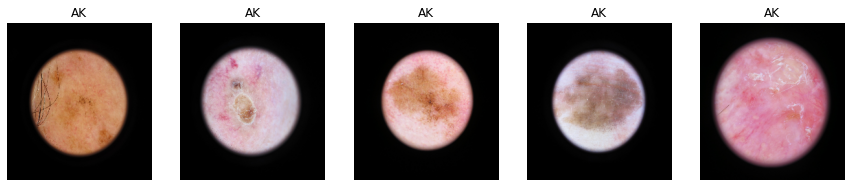

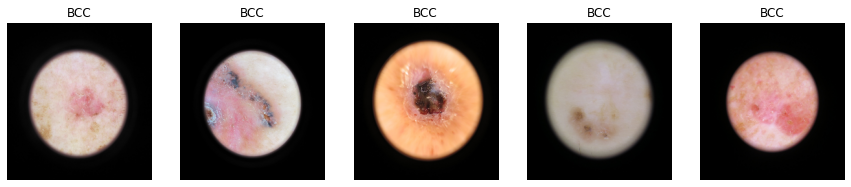

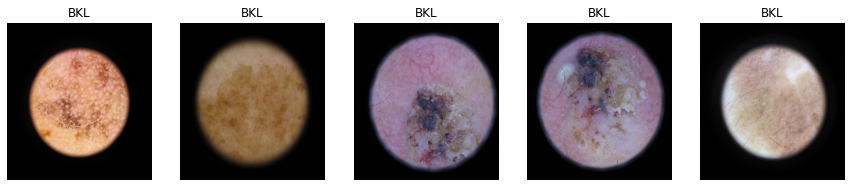

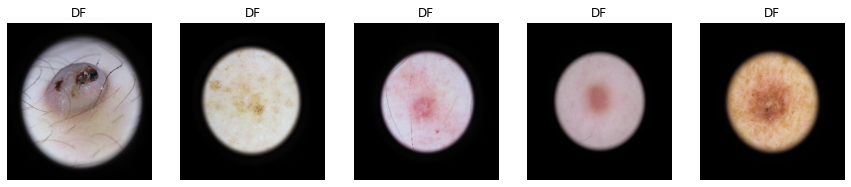

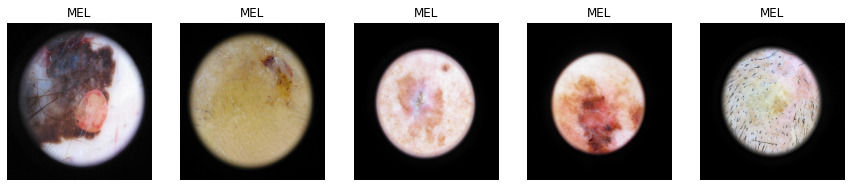

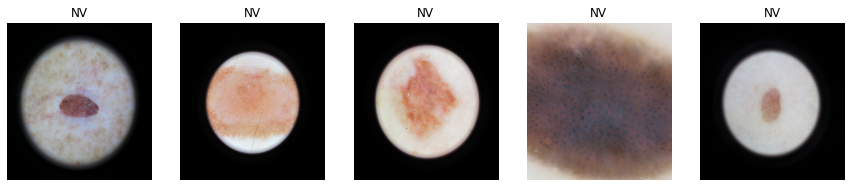

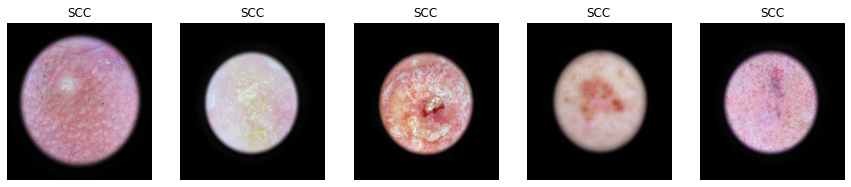

<Figure size 1080x1080 with 0 Axes>

In [ ]:
for i in range(8):
  visualize_images(df_outlier_,i, row_col=(1,5), figsize= (15,15))

In [ ]:
for i in range(8):
  visualize_images(df_outlier_,i, row_col=(1,5), figsize= (15,15), microscopy_crop = True)

In [ ]:
df_outlier_.shape

(1359, 3)

In [ ]:
import pandas as pd
!cp /content/drive/MyDrive/ISIC/2019/test_outliers.csv ./
df_outlier_ = pd.read_csv(f'test_outliers.csv').reset_index(drop=True)

In [ ]:
import random
import matplotlib.pyplot as plt
import numpy as np
import cv2
def visualize_images_test(df, row_col=(4,4), figsize=(12,12), microscopy_crop=False):
  plt.figure(figsize=figsize)
  plt.tight_layout
  p = np.array(df.loc[:,'path'])
  row, col = row_col
  r=500
  for k in range(row*col):
    try:
      # r = np.random.randint(len(p)-1)
      r = r+1
    except:
      continue
    i = p[r]
    img = cv2.imread(i); 
    # img = cv2.resize(img, (224,244))
    if r == 600:
      break
    if microscopy_crop:
      img = crop_microscopy(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  
    plt.subplot(row,col,k+1); plt.imshow(img/255.)
    plt.axis("off")
    # plt.title(p[r], fontsize=12); plt.axis("off")

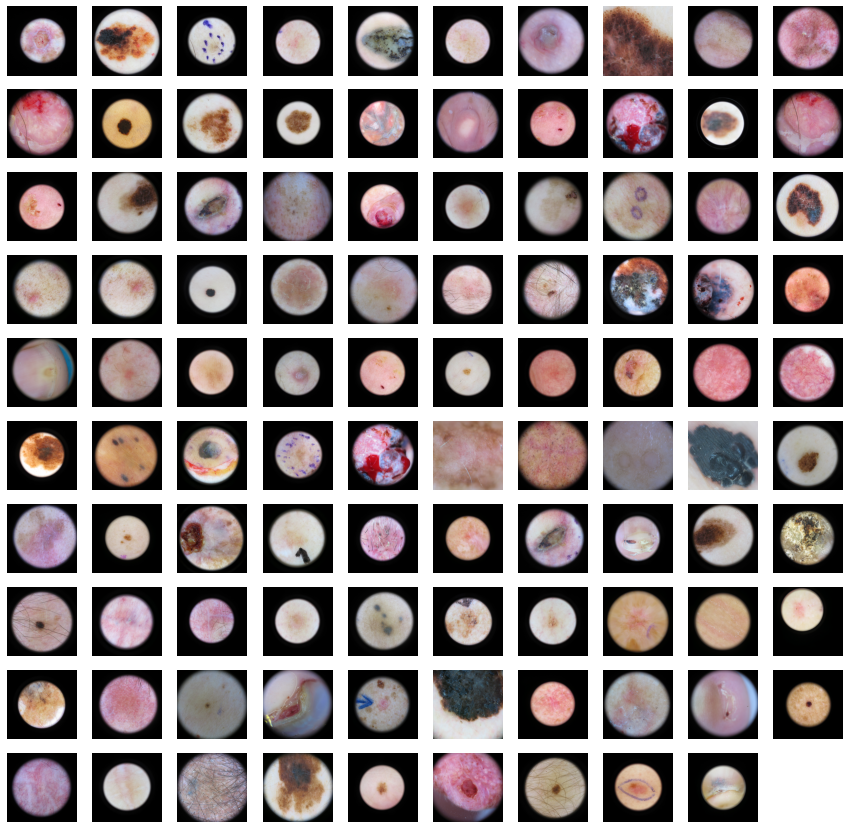

In [ ]:
visualize_images_test(df_outlier_,row_col=(10,10), figsize= (15,15), microscopy_crop = False)

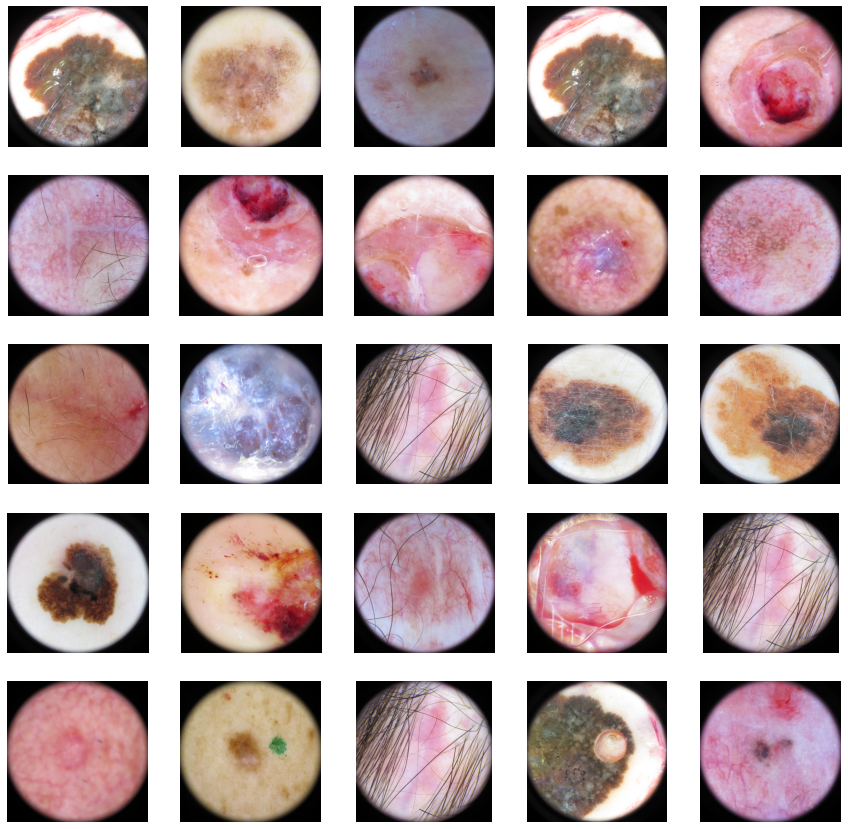

In [ ]:
visualize_images_test(df_outlier_,row_col=(5,5), figsize= (15,15), microscopy_crop = True)

In [ ]:
df_outlier_.shape

(735, 1)

# Feature extractor


## Dataset & Dataloader

In [ ]:
import torch
import albumentations as A

class Load_Dataset(torch.utils.data.Dataset):
    def __init__(self,df):
        self.image_paths = df['path']
        self.labels = df['target']
        self.default_transform = A.Compose([
            A.Normalize((0.6670, 0.5290, 0.5240),
                      (0.2239, 0.2037, 0.2155),always_apply=True),
            A.Resize(224,224),
        ])
        
    def __len__(self):
        return self.image_paths.shape[0]
    
    def __getitem__(self,idx):
        img_path = self.image_paths[idx]
        image = cv2.cvtColor(cv2.imread(img_path),cv2.COLOR_BGR2RGB)
        image = self.default_transform(image=image)['image']        
        image = image.transpose(2, 0, 1)
        image = torch.tensor(image).float()
        label = torch.tensor(self.labels[idx])

        return image,label

In [ ]:
from torchvision import models
from tqdm.notebook import tqdm
#Load dataset
train_data = Load_Dataset(df)
train_loader = torch.utils.data.DataLoader(train_data,batch_size=128)

#loading pretrained model for vgg19
vgg_m = models.vgg19(pretrained=True)
#taking only the first layer from classifier (4096)
vgg_m.classifier = torch.nn.Sequential(vgg_m.classifier[0])
output_descriptor = np.zeros((1,4096))
output_label = np.zeros((1))
device = 'cuda'
vgg_m.to(device)
with torch.no_grad():
    for _, (images,labels) in tqdm(enumerate(train_loader)):
        images,labels = images.to(device),labels.to(device)
        #evaluating the image with pretrained model
        vgg_m.eval()
        pred = vgg_m(images)
        #concatenating all the outputs and labels as a batch of 128 and store in a variable
        output_descriptor =np.concatenate((output_descriptor,pred.cpu().numpy().squeeze()),0)
        output_label = np.concatenate((output_label,labels.cpu().numpy()))
output_descriptor = output_descriptor[1:]
output_label = output_label[1:]

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

0it [00:00, ?it/s]

In [ ]:
# from numpy import savetxt
# output_label
# savetxt('output_label', output_label, delimiter=',')

In [ ]:
# output_descriptor
# savetxt('output_descriptor', output_descriptor, delimiter=',')

In [ ]:
# !cp output_descriptor.csv /content/drive/MyDrive/ISIC/Descriptors/
# !cp output_descriptor /content/drive/MyDrive/ISIC/Descriptors/
# !cp output_label.csv /content/drive/MyDrive/ISIC/Descriptors/
# !cp output_label.csv /content/drive/MyDrive/ISIC/Descriptors/

## PCA

In [ ]:
import time
from sklearn.decomposition import PCA
st_time = time.time()
#extracting top principal component features
pca = PCA(n_components=3)
pca_result_train = pca.fit_transform(output_descriptor)

print('PCA done; Time take {} seconds'.format(time.time()-st_time))
print('Variance: {}'.format(pca.explained_variance_ratio_))
print('Sum of variance in data by first top ten components: {:.2f}%'.format(100*(pca.explained_variance_ratio_.sum())))

##PCA df
pca_tr = pd.DataFrame()
for idx in range(pca_result_train.shape[1]):
    pca_tr['pca'+str(idx+1)] = pca_result_train[:,idx]

pca_tr['target'] = output_label.astype(int)
# pca_tr['diagnosis'] = pca_tr['target'].apply(lambda x: disease_names[str(x)])
pca_tr.head()

PCA done; Time take 14.459062337875366 seconds
Variance: [0.20185373 0.15416781 0.06998824]
Sum of variance in data by first top ten components: 42.60%


,pca1,pca2,pca3,target
0,3.607564,-13.834566,-18.738797,5
1,-21.163525,16.427807,-29.978385,5
2,53.894584,-13.518589,2.814310,4
3,-6.221624,35.126657,-20.471967,5
4,79.532749,12.088883,-53.565204,4


In [ ]:
import plotly.graph_objects as go
fig = go.Figure()
colors = ['rgba(13, 200, 58, 0.3)','rgba(13, 160, 200, 0.3)','rgba(190, 81, 249, 0.3)','rgba(248, 104, 73, 0.3)','rgba(243, 247, 15, 0.3)','rgba(53, 51, 120, 0.3)','rgba(136, 206, 14, 0.3)','rgba(159, 96, 67, 0.3)','rgba(237, 218, 14, 0.3)']
for idx,dn in enumerate(pca_tr['target'].unique()):
    df = pca_tr[pca_tr['target'] == dn]
    fig.add_trace(go.Scatter3d(x=df['pca1'],y=df['pca2'],z=df['pca3'],mode='markers',marker_color = colors[idx],name=str(dn)))
    # fig.add_trace(go.scatter(x=df['pca1'],y=df['pca2'],mode='markers',marker_color = colors[idx],name=str(dn)))
fig.update_layout(title='PCA 1 Vs PCA 2 Vs PCA 3')
fig.show()

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [ ]:
df_ = pd.read_csv(f'train_whole_no_duplicates.csv').reset_index(drop=True)
df_val = pd.read_csv(f'val_whole_no_duplicates.csv').reset_index(drop=True)

## T-SNE

In [ ]:
from sklearn.manifold import TSNE
st_time = time.time()
t_sne = TSNE(random_state=2020)
t_sne_tr = t_sne.fit_transform(output_descriptor)
print('TNSE done; Time take {} seconds'.format(time.time()-st_time))



/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



TNSE done; Time take 835.1681411266327 seconds


In [ ]:
##T-SNE df
tsne_tr = pd.DataFrame()
for idx in range(t_sne_tr.shape[1]):
    tsne_tr['t_sne'+str(idx+1)] = t_sne_tr[:,idx]
tsne_tr['label'] = output_label.astype(int)
# tsne_tr['disease_name'] = tsne_tr['label'].apply(lambda x: disease_names[str(x)])
tsne_tr.head()

,t_sne1,t_sne2,label
0,-4.592042,-13.700796,5
1,-7.583181,-16.394529,5
2,26.029348,0.971670,4
3,-7.363723,-17.924534,5
4,45.952488,-17.476439,4


In [ ]:
layout = {
    # 'showlegend': False,
    'xaxis': {
        'showgrid': False
        },
    'yaxis': {
      'showgrid': False,
      'showline': True
        },
    'plot_bgcolor':'rgb(255,255,255)'
    # 'paper_bgcolor':'rgb(0,0,0)',
}

fig = go.Figure(layout=layout)
colors = ['rgba(13, 200, 58, 0.3)','rgba(13, 160, 200, 0.3)','rgba(190, 81, 249, 0.3)','rgba(248, 104, 73, 0.3)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.3)','rgba(136, 206, 14, 0.3)','rgba(159, 96, 67, 0.3)','rgba(237, 218, 14, 0.3)']
for idx,dn in enumerate(tsne_tr['label'].unique()):
    df = tsne_tr[tsne_tr['label'] == dn]
    fig.add_trace(go.Scatter(x=df['t_sne1'],y=df['t_sne2'],mode='markers',marker_color = colors[idx],name=str(dn)))

# fig.update_layout(paper_bgcolor="rgb(0,0,0,0)")
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)
# fig.update_layout(title='TSNE 1 Vs TSNE 2')
fig.update_xaxes(title_text="TSNE_1")
fig.update_yaxes(title_text="TSNE_2")
fig.show()

In [ ]:
layout = {
    # 'showlegend': False,
    'xaxis': {
        'showgrid': False
        },
    'yaxis': {
      'showgrid': False,
      'showline': True
        },
    'plot_bgcolor':'rgb(255,255,255)'
    # 'paper_bgcolor':'rgb(0,0,0)',
}

fig = go.Figure(layout=layout)
colors = ['rgba(13, 200, 58, 0.3)','rgba(13, 160, 200, 0.3)','rgba(190, 81, 249, 0.3)','rgba(248, 104, 73, 0.3)','rgba(255, 0, 0, 0.3)','rgba(53, 51, 120, 0.3)','rgba(136, 206, 14, 0.3)','rgba(159, 96, 67, 0.3)','rgba(237, 218, 14, 0.0)']
for idx,dn in enumerate(tsne_tr['label'].unique()):
    df = tsne_tr[tsne_tr['label'] == dn]
    fig.add_trace(go.Scatter(x=df['t_sne1'],y=df['t_sne2'],mode='markers',marker_color = colors[idx],name=str(dn)))

# fig.update_layout(paper_bgcolor="rgb(0,0,0,0)")
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)
# fig.update_layout(title='TSNE 1 Vs TSNE 2')
fig.update_xaxes(title_text="TSNE_1")
fig.update_yaxes(title_text="TSNE_2")
fig.show()

In [ ]:
st_time = time.time()
t_sne = TSNE(random_state=2022, perplexity=5, learning_rate=300)
t_sne_tr = t_sne.fit_transform(output_descriptor)
print('TNSE done; Time take {} seconds'.format(time.time()-st_time))

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.



TNSE done; Time take 671.4692831039429 seconds


In [ ]:
##T-SNE df
tsne_tr = pd.DataFrame()
for idx in range(t_sne_tr.shape[1]):
    tsne_tr['t_sne'+str(idx+1)] = t_sne_tr[:,idx]
tsne_tr['label'] = output_label.astype(int)
# tsne_tr['disease_name'] = tsne_tr['label'].apply(lambda x: disease_names[str(x)])
tsne_tr.head()

,t_sne1,t_sne2,label
0,-12.555218,-70.229179,5
1,-44.882515,-28.609697,5
2,33.482174,-23.158747,4
3,-19.763605,-69.708733,5
4,72.417877,-8.356387,4


In [ ]:
layout = {
    # 'showlegend': False,
    'xaxis': {
        'showgrid': False
        },
    'yaxis': {
      'showgrid': False,
      'showline': True
        },
    'plot_bgcolor':'rgb(255,255,255)'
    # 'paper_bgcolor':'rgb(0,0,0)',
}

fig = go.Figure(layout=layout)
colors = ['rgba(13, 200, 58, 0.9)','rgba(13, 160, 200, 0.9)','rgba(190, 81, 249, 0.9)','rgba(248, 104, 73, 0.9)','rgba(255, 0, 0, 0.9)','rgba(53, 51, 120, 0.9)','rgba(136, 206, 14, 0.9)','rgba(159, 96, 67, 0.9)','rgba(237, 218, 14, 0.0)']
for idx,dn in enumerate(tsne_tr['label'].unique()):
    df = tsne_tr[tsne_tr['label'] == dn]
    fig.add_trace(go.Scatter(x=df['t_sne1'],y=df['t_sne2'],mode='markers',marker_color = colors[idx],name=str(dn)))

# fig.update_layout(paper_bgcolor="rgb(0,0,0,0)")
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)
# fig.update_layout(title='TSNE 1 Vs TSNE 2')
fig.update_xaxes(title_text="TSNE_1")
fig.update_yaxes(title_text="TSNE_2")
fig.show()

# Meta data




Adapted from:
@[MEKHDI GAKHRAMANIAN](https://www.kaggle.com/code/mekhdigakhramanian/siim-eda-stacking-top8-0-96)

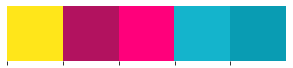

In [ ]:
import pandas as pd
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import io
import plotly.offline as py#visualization
py.init_notebook_mode(connected=True)#visualization
import plotly.graph_objs as go#visualization
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization

import seaborn as sns
import plotly.express as px

# import pydicom # for DICOM images
from skimage.transform import resize

# SKLearn
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

import os
import random
import re
import math
import time
from IPython.display import display_html
import missingno as msno 
import gc
import cv2
import matplotlib.image as mpimg

# Set Color Palettes for the notebook (https://color.adobe.com/)
colors_nude = ['#FFE61A','#B2125F','#FF007B','#14B4CC','#099CB3']
sns.palplot(sns.color_palette(colors_nude))

# Set Style
sns.set_style("whitegrid")
sns.despine(left=True, bottom=True)


import warnings

warnings.filterwarnings('ignore') # Disabling warnings for clearer outputs


seed_val = 42
random.seed(seed_val)
np.random.seed(seed_val)

In [ ]:
train = pd.read_csv(f'whole_data_no_duplicates.csv').reset_index(drop=True)
test_2 = pd.read_csv(f'/content/drive/MyDrive/ISIC/2020/ISIC_2020_Test_Metadata.csv').reset_index(drop=True)
test_2

,image,patient,age_approx,anatom_site_general,sex
0,ISIC_0052060,IP_3579794,70,NaN,male
1,ISIC_0052349,IP_7782715,40,lower extremity,male
2,ISIC_0058510,IP_7960270,55,torso,female
3,ISIC_0073313,IP_6375035,50,torso,female
4,ISIC_0073502,IP_0589375,45,lower extremity,female
...,...,...,...,...,...
10977,ISIC_9992485,IP_4152479,40,torso,male
10978,ISIC_9996992,IP_4890115,35,torso,male
10979,ISIC_9997917,IP_2852390,25,upper extremity,male
10980,ISIC_9998234,IP_8861963,65,lower extremity,male


In [ ]:
train = train.drop(train.columns[[1, 6, 7]], axis=1)  
test = test.drop(test.columns[[4]], axis=1)  

test_2 = test_2.drop(test_2.columns[[1]], axis=1)  

In [ ]:
# checking column names
print(
    f'Train data has {train.shape[1]} features, {train.shape[0]} observations and Test data {test.shape[1]} features, {test.shape[0]} observations.\nTrain features are:\n{train.columns.tolist()}\nTest features are:\n{test.columns.tolist()}'
)

print(
    f'Train data has {train.shape[1]} features, {train.shape[0]} observations and Test data {test_2.shape[1]} features, {test_2.shape[0]} observations.\nTrain features are:\n{train.columns.tolist()}\nTest features are:\n{test_2.columns.tolist()}'
)

Train data has 8 features, 57301 observations and Test data 4 features, 8238 observations.
Train features are:
['image', 'path', 'diagnosis', 'age_approx', 'sex', 'anatom_site_general_challenge', 'target', 'temporal_image']
Test features are:
['image', 'sex', 'age', 'location']
Train data has 8 features, 57301 observations and Test data 4 features, 10982 observations.
Train features are:
['image', 'path', 'diagnosis', 'age_approx', 'sex', 'anatom_site_general_challenge', 'target', 'temporal_image']
Test features are:
['image', 'age_approx', 'anatom_site_general', 'sex']


In [ ]:
train.columns = [
    'image', 'diagnosis', 'sex', 'age', 'location',
]

test.columns = ['image','sex', 'age', 'location']

test_2.columns = ['image','age', 'location', 'sex']

In [ ]:
train_df = train.copy()
test_df = test.copy()

test2_df = test_2.copy()
df1_styler = train_df.head().style.set_table_attributes("style='display:inline'").set_caption('Head Train Data')
df2_styler = test_df.head().style.set_table_attributes("style='display:inline'").set_caption('Head Test Data')

df2_styler = test2_df.head().style.set_table_attributes("style='display:inline'").set_caption('Head Test Data')

display_html(df1_styler._repr_html_() + df2_styler._repr_html_(), raw=True)

Head Train Data 
 
 
   
 image 
 diagnosis 
 sex 
 age 
 location 
 
 
 
 
 0 
 ISIC_0000000 
 NV 
 55.000000 
 female 
 anterior torso 
 
 
 1 
 ISIC_0000001 
 NV 
 30.000000 
 female 
 anterior torso 
 
 
 2 
 ISIC_0000002 
 MEL 
 60.000000 
 female 
 upper extremity 
 
 
 3 
 ISIC_0000003 
 NV 
 30.000000 
 male 
 upper extremity 
 
 
 4 
 ISIC_0000004 
 MEL 
 80.000000 
 male 
 posterior torso 
 
 
 

 
 Head Test Data 
 
 
   
 image 
 age 
 location 
 sex 
 
 
 
 
 0 
 ISIC_0052060 
 70 
 nan 
 male 
 
 
 1 
 ISIC_0052349 
 40 
 lower extremity 
 male 
 
 
 2 
 ISIC_0058510 
 55 
 torso 
 female 
 
 
 3 
 ISIC_0073313 
 50 
 torso 
 female 
 
 
 4 
 ISIC_0073502 
 45 
 lower extremity 
 female

# Check missing values

In [ ]:
test2_df

,image,age,location,sex
0,ISIC_0052060,70,NaN,male
1,ISIC_0052349,40,lower extremity,male
2,ISIC_0058510,55,torso,female
3,ISIC_0073313,50,torso,female
4,ISIC_0073502,45,lower extremity,female
...,...,...,...,...
10977,ISIC_9992485,40,torso,male
10978,ISIC_9996992,35,torso,male
10979,ISIC_9997917,25,upper extremity,male
10980,ISIC_9998234,65,lower extremity,male


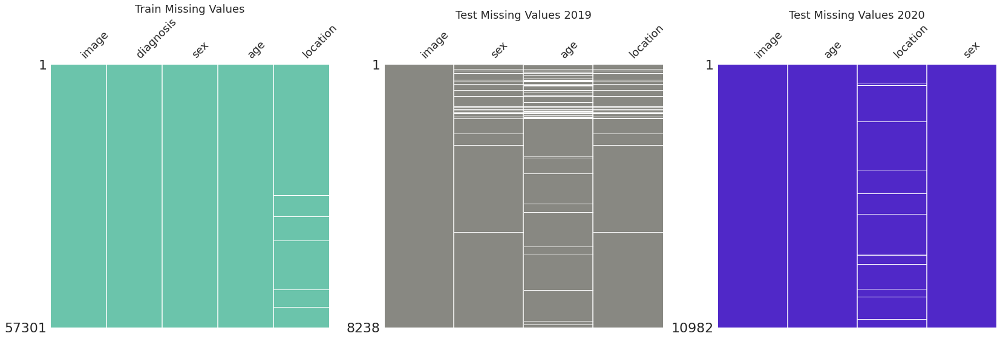

In [ ]:
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = (28,8))

size_ = 18 
msno.matrix(train_df, ax = ax1, color=(107/255, 196/255, 171/255), fontsize=size_)
msno.matrix(test_df, ax = ax2, color=(136/255, 136/255, 130/255), fontsize=size_)
msno.matrix(test2_df, ax = ax3, color=(80/255, 40/255, 200/255), fontsize=size_)

ax1.set_title('Train Missing Values', fontsize = size_)
ax2.set_title('Test Missing Values 2019', fontsize = size_);
ax3.set_title('Test Missing Values 2020', fontsize = size_);

# Sunburstt

In [ ]:
df_temporal

,diagnosis,images,outliers
0,NV,13448,No
1,NV,287,Yes
2,MEL,4421,No
3,MEL,447,Yes
4,BKL,2593,No
5,BKL,136,Yes
6,DF,263,No
7,DF,13,Yes
8,SCC,565,No
9,SCC,63,Yes


In [ ]:

fig = px.sunburst(data_frame=df_temporal,
                  path=['diagnosis','images'],
                  color='diagnosis',
                  # color_discrete_sequence=colors_nude,
                  maxdepth=-1,
                  title='Sunburst Chart Anatomical location vs Age')

fig.update_traces(textinfo='label+percent parent')
fig.update_layout(margin=dict(t=50, l=0, r=0, b=0))
fig.show(renderer="colab")

In [ ]:
# Filling missing  values with 'unknown' and '-1' tags:

for df in [train, test]:
    df['location'].fillna('unknown', inplace=True)
    
train['sex'].fillna('unknown', inplace=True)

train['age'].fillna(-1, inplace=True)

In [ ]:

# Plotting interactive sunburst:

fig = px.sunburst(data_frame=train,
                  path=['diagnosis','age'],
                  color='diagnosis',
                  # color_discrete_sequence=colors_nude,
                  maxdepth=-1,
                  title='Sunburst Chart Anatomical location vs Age')

fig.update_traces(textinfo='label+percent parent')
fig.update_layout(margin=dict(t=50, l=0, r=0, b=0))
fig.show(renderer="colab")

In [ ]:

# Plotting interactive sunburst:

fig = px.sunburst(data_frame=train,
                  path=['location','age'],
                  color='location',
                  # color_discrete_sequence=colors_nude,
                  maxdepth=-1,
                  title='Sunburst Chart Anatomical location vs Age')

fig.update_traces(textinfo='label+percent parent')
fig.update_layout(margin=dict(t=50, l=0, r=0, b=0))
fig.show(renderer="colab")

# Anatomy and Diagnosis

In [ ]:
train_df.shape

(57301, 6)

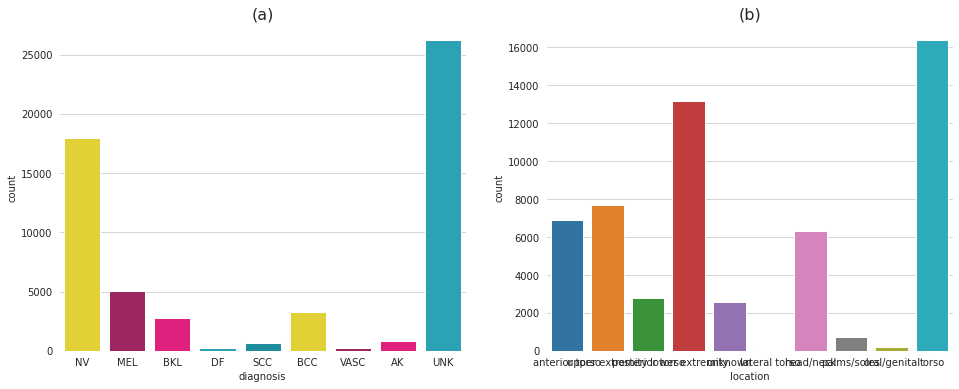

In [ ]:
# Figure
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16, 6))

a = sns.countplot(train_df['diagnosis'], ax=ax1, palette = colors_nude)
b = sns.countplot(train_df['location'], ax=ax2)

# a.set_xticklabels(a.get_xticklabels(), rotation=35, ha="right", fontsize =14)
# b.set_xticklabels(b.get_xticklabels(), rotation=35, ha="right", fontsize =14)

# for p in a.patches:
#     a.annotate(format(p.get_height(), ','), 
#            (p.get_x() + p.get_width() / 2., 
#             p.get_height()), ha = 'center', va = 'center', 
#            xytext = (0, 6), textcoords = 'offset points', fontsize =12)
    
# for p in b.patches:
#     b.annotate(format(p.get_height(), ','), 
#            (p.get_x() + p.get_width() / 2., 
#             p.get_height()), ha = 'center', va = 'center', 
#            xytext = (0, 6), textcoords = 'offset points', fontsize =12)
    
ax1.set_title('(a)', fontsize=16)
ax2.set_title('(b)', fontsize=16)
sns.despine(left=True, bottom=True);

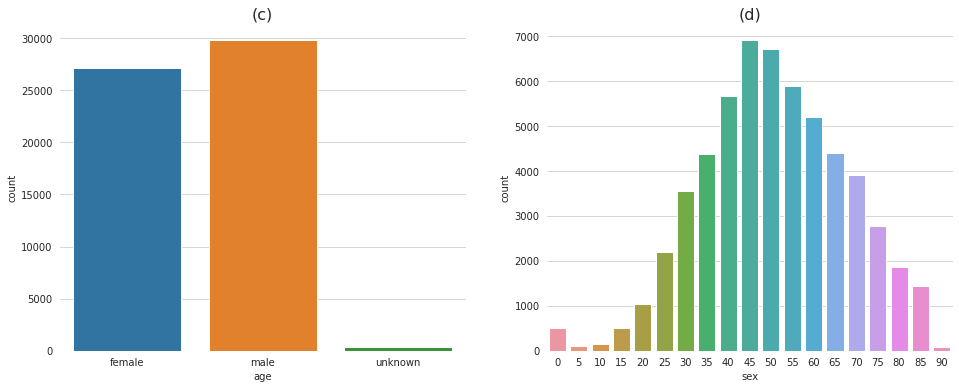

In [ ]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16, 6))

# train_df['sex1'] = df['sex'].astype(int)
train_df['sex'] = train_df['sex'].fillna(0).astype(int)
a = sns.countplot(train_df['age'], ax=ax1)
b = sns.countplot(train_df['sex'], ax=ax2)



# a.set_xticklabels(a.get_xticklabels(), rotation=35, ha="right", fontsize =12)
# b.set_xticklabels(b.get_xticklabels(), rotation=35, ha="right", fontsize =12)

# for p in a.patches:
#     a.annotate(format(p.get_height(), ','), 
#            (p.get_x() + p.get_width() / 2., 
#             p.get_height()), ha = 'center', va = 'center', 
#            xytext = (0, 7), textcoords = 'offset points', fontsize =14)
    
# for p in b.patches:
#     b.annotate(format(p.get_height(), ','), 
#            (p.get_x() + p.get_width() / 2., 
#             p.get_height()), ha = 'center', va = 'center', 
#            xytext = (0, 7), textcoords = 'offset points', fontsize =14)
    
ax1.set_title('(c)', fontsize=16)
ax2.set_title('(d)', fontsize=16)
sns.despine(left=True, bottom=True);

# Basic meta

In [ ]:
import os
import pandas as pd

import matplotlib.pyplot as plt
from skimage import io
import random

In [ ]:
PATH = './'
os.listdir(PATH)

['.config',
 'ISIC_2019_Test_Metadata.csv',
 'ISIC_2019_Training_GroundTruth.csv',
 'ISIC_2019_Training_Metadata.csv',
 'sample_data']

In [ ]:
train_target = pd.read_csv(f'{PATH}/ISIC_2019_Training_GroundTruth.csv')
train_target.head()

,image,MEL,NV,BCC,AK,BKL,DF,VASC,SCC,UNK
0,ISIC_0000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ISIC_0000001,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,ISIC_0000002,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,ISIC_0000003,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,ISIC_0000004,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
train = pd.read_csv(f'{PATH}/ISIC_2019_Training_Metadata.csv')
train.head()

,image,age_approx,anatom_site_general,lesion_id,sex
0,ISIC_0000000,55.0,anterior torso,NaN,female
1,ISIC_0000001,30.0,anterior torso,NaN,female
2,ISIC_0000002,60.0,upper extremity,NaN,female
3,ISIC_0000003,30.0,upper extremity,NaN,male
4,ISIC_0000004,80.0,posterior torso,NaN,male


In [ ]:
test = pd.read_csv(f'{PATH}/ISIC_2019_Test_Metadata.csv')
test.head()

,image,age_approx,anatom_site_general,sex
0,ISIC_0034321,60.0,NaN,female
1,ISIC_0034322,70.0,anterior torso,male
2,ISIC_0034323,70.0,lower extremity,male
3,ISIC_0034324,70.0,lower extremity,male
4,ISIC_0034325,30.0,upper extremity,female


In [ ]:
r, c = 3, 5
fig = plt.figure(figsize=(2*c, 2*r))
for _r in range(r):
    for _c in range(c):
        plt.subplot(r, c, _r*c + _c + 1)
        ix = random.randint(0, len(train))
        name = train["image_name"].values[ix]
        img = io.imread(f'{PATH}/jpeg224/train/{name}.jpg')
        plt.imshow(img)
        label = train["target"].values[ix]
        plt.title(label)
        plt.axis(False)
plt.show()

In [ ]:
for col in train_target.columns:
    print(train_target[col].value_counts())
    print("\n")

ISIC_0000000    1
ISIC_0059830    1
ISIC_0059827    1
ISIC_0059826    1
ISIC_0059824    1
               ..
ISIC_0029844    1
ISIC_0029843    1
ISIC_0029842    1
ISIC_0029841    1
ISIC_0073254    1
Name: image, Length: 25331, dtype: int64


0.0    20809
1.0     4522
Name: MEL, dtype: int64


1.0    12875
0.0    12456
Name: NV, dtype: int64


0.0    22008
1.0     3323
Name: BCC, dtype: int64


0.0    24464
1.0      867
Name: AK, dtype: int64


0.0    22707
1.0     2624
Name: BKL, dtype: int64


0.0    25092
1.0      239
Name: DF, dtype: int64


0.0    25078
1.0      253
Name: VASC, dtype: int64


0.0    24703
1.0      628
Name: SCC, dtype: int64


0.0    25331
Name: UNK, dtype: int64




array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7ff72a14b350>,
      dtype=object)

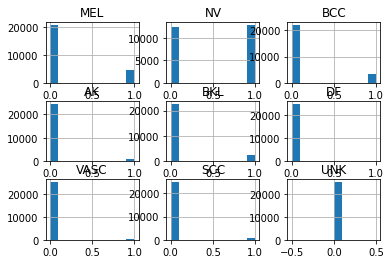

In [ ]:
train_target.hist()


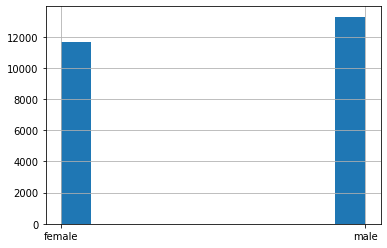

In [ ]:
train['sex'].hist()

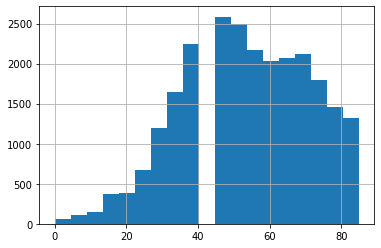

In [ ]:
train['age_approx'].hist(bins=len(train['age_approx'].unique()))

In [ ]:
train['age_approx'].value_counts()

45.0    2585
50.0    2489
40.0    2246
55.0    2170
70.0    2120
65.0    2075
60.0    2036
75.0    1796
35.0    1651
80.0    1459
85.0    1319
30.0    1199
25.0     677
20.0     388
15.0     375
10.0     142
5.0      113
0.0       54
Name: age_approx, dtype: int64

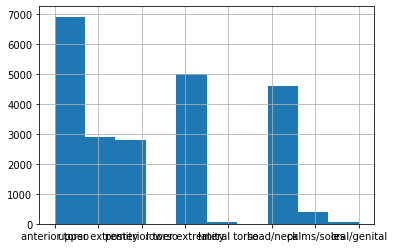

In [ ]:
train['anatom_site_general'].hist()

In [ ]:
train.shape, test.shape

((25331, 5), (8238, 4))

In [ ]:
from sklearn.model_selection import train_test_split

train_split, val_split = train_test_split(train, random_state=42, test_size=0.33, shuffle=True, stratify=train['target'])

train_split.shape, val_split.shape

((22194, 8), (10932, 8))

In [ ]:
((22194, 8), (10932, 8))
train_split.to_csv(f'{PATH}/train_split.csv', index=False)
val_split.to_csv(f'{PATH}/val_split.csv', index=False)

In [ ]:
_, subset = train_test_split(train_split, random_state=42, test_size=0.1, shuffle=True, stratify=train_split['target'])
subset.shape

(2220, 8)

In [ ]:
subset.to_csv(f'{PATH}/subset.csv', index=False)